In [1]:
import torch
import matplotlib
import matplotlib.pyplot as plt
import time
import h5py
import torch.optim as optim
import torch.nn as nn
import numpy as np
import math
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from torchvision.utils import save_image
matplotlib.style.use('ggplot')

c:\Users\amant\AppData\Local\Programs\Python\Python310\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# learning parameters
batch_size = 64 # batch size, reduce if facing OOM error
epochs = 10 # number of epochs to train the SRCNN model for
lr = 0.001 # the learning rate
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
# input image dimensions
size =64
img_rows, img_cols = size,size
out_rows, out_cols = size,size

In [4]:
# Import necessary libraries
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
import numpy as np
from PIL import Image
# from pydrive.auth import GoogleAuth
# from pydrive.drive import GoogleDrive
# from google.colab import auth
# from oauth2client.client import GoogleCredentials
import matplotlib.pyplot as plt

In [5]:
from torchvision import datasets, transforms
import torchvision.transforms as transforms

In [6]:
import os

Device choosing GPU -ON/OFF

In [7]:
torch.cuda.is_available()

True

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [9]:
torch.cuda.is_available()

True

In [10]:
# Define the dataset class
class DriveImageDataset(Dataset):
    def __init__(self, filenames, transform=None):
        self.filenames = filenames
        self.transform = transform
        
    def __len__(self):
        return len(self.filenames)
    
    def __getitem__(self, idx):
        filename = self.filenames[idx]
        img = Image.open(filename)
        if self.transform:
            img = self.transform(img)
        return img, filename

In [11]:
# Define the directory containing the images
input_directory = "Bioimaging_data3/A0.3/"
target_directory = "Bioimaging_data3/A0.7/"

In [12]:
def filename_gen(dir_path):
  # Get a list of all image files in the directory
  image_files = [f for f in os.listdir(dir_path) ] # if f.endswith(".jpg")

  # Extract the file names and store them in a list
  file_names = [f for f in image_files] # os.path.splitext(f)[0]

  # Sort the file names alphabetically
  file_names.sort()

  file_pth = []

  for i in range(len(file_names)):
    file_pth.append(dir_path+file_names[i])

  return file_names,file_pth

In [13]:
input_file_pth = filename_gen(input_directory)[1]
target_file_pth =filename_gen(target_directory)[1]
print("input path:",input_file_pth)
print("target path:",target_file_pth)

input path: ['Bioimaging_data3/A0.3/103064_0.3.jpg', 'Bioimaging_data3/A0.3/103071_0.3.jpg', 'Bioimaging_data3/A0.3/103072_0.3.jpg', 'Bioimaging_data3/A0.3/103081_0.3.jpg', 'Bioimaging_data3/A0.3/103082_0.3.jpg', 'Bioimaging_data3/A0.3/103091_0.3.jpg', 'Bioimaging_data3/A0.3/103092_0.3.jpg', 'Bioimaging_data3/A0.3/103093_0.3.jpg', 'Bioimaging_data3/A0.3/103094_0.3.jpg', 'Bioimaging_data3/A0.3/103095_0.3.jpg', 'Bioimaging_data3/A0.3/103101_0.3.jpg', 'Bioimaging_data3/A0.3/103111_0.3.jpg', 'Bioimaging_data3/A0.3/103112_0.3.jpg', 'Bioimaging_data3/A0.3/103113_0.3.jpg', 'Bioimaging_data3/A0.3/103121_0.3.jpg', 'Bioimaging_data3/A0.3/103131_0.3.jpg', 'Bioimaging_data3/A0.3/103132_0.3.jpg', 'Bioimaging_data3/A0.3/103133_0.3.jpg', 'Bioimaging_data3/A0.3/103141_0.3.jpg', 'Bioimaging_data3/A0.3/103142_0.3.jpg', 'Bioimaging_data3/A0.3/103143_0.3.jpg', 'Bioimaging_data3/A0.3/103161_0.3.jpg', 'Bioimaging_data3/A0.3/103162_0.3.jpg', 'Bioimaging_data3/A0.3/103163_0.3.jpg', 'Bioimaging_data3/A0.3/1031

In [14]:
input_file_ids = filename_gen(input_directory)[0]
target_file_ids =filename_gen(target_directory)[0]
print("input filename:",input_file_ids)
print("target filename:",target_file_ids)

input filename: ['103064_0.3.jpg', '103071_0.3.jpg', '103072_0.3.jpg', '103081_0.3.jpg', '103082_0.3.jpg', '103091_0.3.jpg', '103092_0.3.jpg', '103093_0.3.jpg', '103094_0.3.jpg', '103095_0.3.jpg', '103101_0.3.jpg', '103111_0.3.jpg', '103112_0.3.jpg', '103113_0.3.jpg', '103121_0.3.jpg', '103131_0.3.jpg', '103132_0.3.jpg', '103133_0.3.jpg', '103141_0.3.jpg', '103142_0.3.jpg', '103143_0.3.jpg', '103161_0.3.jpg', '103162_0.3.jpg', '103163_0.3.jpg', '103181_0.3.jpg', '103182_0.3.jpg', '103183_0.3.jpg', '103184_0.3.jpg', '103191_0.3.jpg', '103192_0.3.jpg', '103193_0.3.jpg', '103201_0.3.jpg', '103202_0.3.jpg', '103203_0.3.jpg', '103212_0.3.jpg', '103213_0.3.jpg', '103214_0.3.jpg', '103215_0.3.jpg', '103221_0.3.jpg', '1032291_0.3.jpg', '1032292_0.3.jpg', '1032293_0.3.jpg', '1032302_0.3.jpg', '1032303_0.3.jpg', '103231_0.3.jpg', '103232_0.3.jpg', '104011_0.3.jpg', '104013_0.3.jpg', '104022_0.3.jpg', '104023_0.3.jpg', '104024_0.3.jpg', '104031_0.3.jpg', '104032_0.3.jpg', '104033_0.3.jpg', '10406

In [15]:
transform = transforms.Compose([
    # transforms.ToPILImage(),
    transforms.Resize((64, 64)),
    # transforms.Grayscale,
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [16]:
# Load the input and target images into dataloaders
input_dataset = DriveImageDataset(input_file_pth, transform=transform)
target_dataset = DriveImageDataset(target_file_pth, transform=transform)

In [17]:
input_dataloader = DataLoader(dataset=input_dataset, batch_size=1, shuffle=False)

In [18]:
target_dataloader = DataLoader(dataset=target_dataset, batch_size=1, shuffle=False)

In [19]:
images,labels=next(iter(input_dataloader))
print("Shape of image: {}".format(images.shape))
images = images.numpy()
# labels=labels.numpy()
# print(images.shape)
images,labels

Shape of image: torch.Size([1, 1, 64, 64])


(array([[[[ 0.85882354,  0.85882354,  0.88235295, ...,  0.8352941 ,
            0.8117647 ,  0.8509804 ],
          [ 0.85882354,  0.8509804 ,  0.8666667 , ...,  0.9607843 ,
            0.96862745,  0.9372549 ],
          [ 0.8666667 ,  0.85882354,  0.8666667 , ...,  0.90588236,
            0.92156863,  0.9137255 ],
          ...,
          [ 0.7882353 ,  0.9137255 ,  0.88235295, ..., -0.04313725,
           -0.04313725,  0.13725495],
          [ 0.7647059 ,  0.94509804,  0.8745098 , ..., -0.01176471,
           -0.01960784,  0.09803927],
          [ 0.78039217,  0.92941177,  0.88235295, ...,  0.10588241,
            0.07450986,  0.19215691]]]], dtype=float32),
 ('Bioimaging_data3/A0.3/103064_0.3.jpg',))

In [20]:
len(input_dataloader),len(target_dataloader)

(5165, 5165)

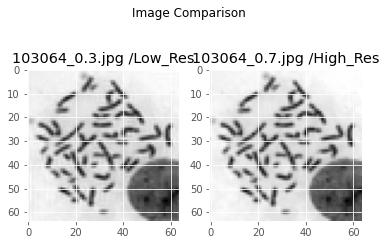

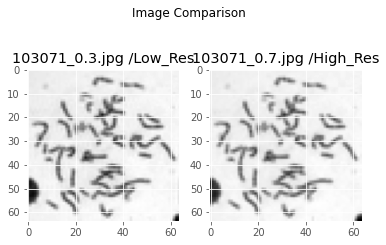

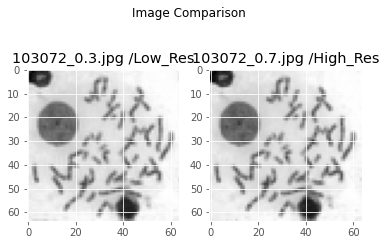

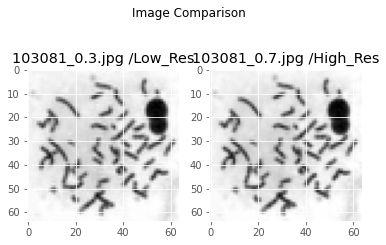

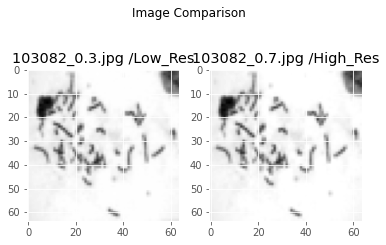

In [21]:
# Loop through the dataloaders and display the images side by side with labels

for i,(image1, filename1) in enumerate(input_dataloader):
    # Get the corresponding image from the second dataloader
    image2, filename2 = target_dataloader.dataset[i]
    
    # Convert the images to numpy arrays
    image1 = image1.squeeze().numpy()
    image2 = image2.squeeze().numpy()
    
    # Create a figure with two subplots and display the images
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.suptitle('Image Comparison')
    ax1.imshow(image1, cmap="gray")

    ax2.imshow(image2, cmap="gray")
    
    # Add labels indicating which set each image belongs to
    ax1.set_title(f"{input_file_ids[i]} /Low_Res")
    
    ax2.set_title(f"{target_file_ids[i]} /High_Res")

    
    plt.show()


    # Stop after displaying 5 pairs of images
    if i == 4:
        break

In [22]:
low_res_img = []
i=0
for images,labels in input_dataloader:
  low_res_img.append(images.numpy())
  i+=1
  # if i == 4:
  #   break

In [23]:
# low_res_img

In [24]:
train_low_image = low_res_img[:4132]
train_low_image = np.reshape(train_low_image,(len(train_low_image),64,64,1))

In [25]:
len(low_res_img)

5165

In [26]:
len(train_low_image)

4132

In [27]:
val_low_image = low_res_img[4132:4648]
val_low_image = np.reshape(val_low_image,(len(val_low_image),64,64,1))

In [28]:
len(val_low_image)

516

In [29]:
test_low_image = low_res_img[4648:]
test_low_image = np.reshape(test_low_image,(len(test_low_image),64,64,1))

In [30]:
test_low_image

array([[[[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 0.99215686],
         [ 0.99215686],
         [ 0.99215686]],

        [[ 1.        ],
         [ 0.99215686],
         [ 0.9764706 ],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 0.99215686]],

        [[ 1.        ],
         [ 0.99215686],
         [ 0.99215686],
         ...,
         [ 0.99215686],
         [ 0.99215686],
         [ 0.9764706 ]],

        ...,

        [[ 0.9764706 ],
         [ 0.96862745],
         [ 0.99215686],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 0.99215686]],

        [[ 0.9843137 ],
         [ 0.9843137 ],
         [ 0.9843137 ],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 0.99215686],
         [ 0.99215686],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 1.        ]]],


       [[[ 1.        ],


In [31]:
# train_low_image

In [32]:
high_res_img = []
i=0
for images,labels in target_dataloader:
  high_res_img.append(images.numpy())
  i+=1
  # if i == 4:
  #   break

In [33]:
# high_res_img

In [34]:
train_high_image = high_res_img[:4132]
train_high_image = np.reshape(train_high_image,(len(train_high_image),64,64,1))

In [35]:
train_high_image

array([[[[ 0.8509804 ],
         [ 0.8666667 ],
         [ 0.88235295],
         ...,
         [ 0.94509804],
         [ 0.9372549 ],
         [ 0.92156863]],

        [[ 0.85882354],
         [ 0.8509804 ],
         [ 0.8666667 ],
         ...,
         [ 0.9372549 ],
         [ 0.9372549 ],
         [ 0.92941177]],

        [[ 0.85882354],
         [ 0.8666667 ],
         [ 0.8666667 ],
         ...,
         [ 0.92941177],
         [ 0.94509804],
         [ 0.9372549 ]],

        ...,

        [[ 0.88235295],
         [ 0.88235295],
         [ 0.8980392 ],
         ...,
         [-0.11372548],
         [-0.02745098],
         [ 0.01176476]],

        [[ 0.88235295],
         [ 0.8980392 ],
         [ 0.8980392 ],
         ...,
         [-0.01960784],
         [ 0.07450986],
         [ 0.01176476]],

        [[ 0.88235295],
         [ 0.90588236],
         [ 0.90588236],
         ...,
         [-0.01176471],
         [-0.00392157],
         [ 0.0196079 ]]],


       [[[ 0.7647059 ],


In [36]:
val_high_image = high_res_img[4132:4648]
val_high_image = np.reshape(val_high_image,(len(val_high_image),64,64,1))

In [37]:
val_high_image

array([[[[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]],

        ...,

        [[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 1.        ],
         [ 1.        ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]]],


       [[[ 1.        ],


In [38]:
test_high_image = high_res_img[4648:]
test_high_image = np.reshape(test_high_image,(len(test_high_image),64,64,1))

In [39]:
test_high_image

array([[[[ 1.        ],
         [ 0.99215686],
         [ 1.        ],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 0.99215686],
         [ 0.9843137 ],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 1.        ],
         [ 0.99215686],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 0.9764706 ]],

        ...,

        [[ 0.9764706 ],
         [ 0.96862745],
         [ 0.99215686],
         ...,
         [ 1.        ],
         [ 1.        ],
         [ 0.99215686]],

        [[ 0.9843137 ],
         [ 0.9764706 ],
         [ 0.9843137 ],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 1.        ]],

        [[ 1.        ],
         [ 1.        ],
         [ 0.99215686],
         ...,
         [ 0.99215686],
         [ 1.        ],
         [ 1.        ]]],


       [[[ 1.        ],


In [40]:
# train_high_image

In [41]:
import torch.nn as nn
import torch.nn.functional as F
class SRCNN(nn.Module):
    def __init__(self):
        super(SRCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 64, kernel_size=9, padding=2, padding_mode='replicate') # padding mode same as original Caffe code
        self.conv2 = nn.Conv2d(64, 32, kernel_size=1, padding=2, padding_mode='replicate')
        self.conv3 = nn.Conv2d(32, 1, kernel_size=5, padding=2, padding_mode='replicate')
        self.relu = nn.ReLU(inplace=True)
    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.relu(self.conv2(x))
        x = self.conv3(x)
        return x

In [42]:
# initialize the model
print('Computation device: ', device)
model = SRCNN().to(device)
print(model)

Computation device:  cuda
SRCNN(
  (conv1): Conv2d(1, 64, kernel_size=(9, 9), stride=(1, 1), padding=(2, 2), padding_mode=replicate)
  (conv2): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1), padding=(2, 2), padding_mode=replicate)
  (conv3): Conv2d(32, 1, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), padding_mode=replicate)
  (relu): ReLU(inplace=True)
)


In [43]:
# Loss functions and Optimizers in use:
def pixel_mse_loss(x, y):
    criterion = nn.MSELoss()
    return criterion(x, y)
def Optim_Functions(model,optim_num):
  Optimizers_list = ["Adam", "Adagrad", "Adadelta", "RMSprop"]
  
  if Optimizers_list[optim_num-1] == "Adam":
    optim = torch.optim.Adam(model.parameters(), lr=1e-3, betas=(0.9, 0.999), weight_decay = 1e-5)
 
  elif Optimizers_list[optim_num-1] == "Adagrad":
    optim = torch.optim.Adagrad(model.parameters(), lr=1e-3, lr_decay= 1e-8, weight_decay=1e-5, initial_accumulator_value=1e-5, eps=1e-10)

  elif Optimizers_list[optim_num-1] == "Adadelta":
    optim = torch.optim.Adadelta(model.parameters(), lr=1e-3, rho=0.9, eps=1e-06, weight_decay = 1e-5)

  elif Optimizers_list[optim_num-1] == "RMSprop":
    optim = torch.optim.RMSprop(model.parameters(), lr=1e-3, alpha=0.99, eps=1e-08, weight_decay=1e-5, momentum=0.9)

  return optim

In [44]:
transform_1 = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((64, 64)),
    # transforms.Grayscale,
    transforms.ToTensor(),
    
])

In [45]:
from torch.utils.data import Dataset, DataLoader

class ImageDataset(Dataset):
    def __init__(self, low_images, high_images):
        self.low_images = low_images
        self.high_images = high_images

    def __len__(self):
        return len(self.low_images)
    
    def __getitem__(self, index):
        low_image = self.low_images[index]
        high_image = self.high_images[index]
        
        # convert to tensor and normalize
        low_image = transform_1(low_image)
        high_image = transform_1(high_image)
        
        return low_image, high_image

In [46]:
batch_size = 1

In [47]:
# create dataset
train_dataset = ImageDataset(train_low_image, train_high_image)

# create data loader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)

In [48]:
val_dataset = ImageDataset(val_low_image, val_high_image)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

In [49]:
test_dataset = ImageDataset(test_low_image, test_high_image)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [50]:
# optimizer
optimizer = Optim_Functions(model,1)
# loss function 
criterion = nn.MSELoss()

In [51]:
def train(model, dataloader):
    model.train()
    running_loss = 0.0
    running_psnr = 0.0
    for bi, data in enumerate(dataloader):
     
        image_low_data = data[0].to(device)
        image_high_data = data[1].to(device)
        
        # zero grad the optimizer
        optimizer.zero_grad()
        outputs = model(image_low_data)
        loss = criterion(outputs, image_high_data)
   
        # backpropagation
        loss.backward()
        # update the parameters
        optimizer.step()
        # add loss of each item (total items in a batch = batch size)
        running_loss += loss.item()
        # calculate batch psnr (once every `batch_size` iterations)
        batch_psnr =  psnr(image_high_data, outputs)
        running_psnr += batch_psnr
    final_loss = running_loss/len(dataloader.dataset)
    final_psnr = running_psnr/int(4132/dataloader.batch_size)
    return final_loss, final_psnr

In [52]:
def psnr(label, outputs, max_val=1.):
    """
    Compute Peak Signal to Noise Ratio (the higher the better).
    PSNR = 20 * log10(MAXp) - 10 * log10(MSE).
    https://en.wikipedia.org/wiki/Peak_signal-to-noise_ratio#Definition
    First we need to convert torch tensors to NumPy operable.
    """
    label = label.cpu().detach().numpy()
    outputs = outputs.cpu().detach().numpy()
    img_diff = outputs - label
    rmse = math.sqrt(np.mean((img_diff) ** 2))
    if rmse == 0:
        return 100
    else:
        PSNR = 20 * math.log10(max_val / rmse)
        return PSNR

In [53]:
len(train_loader.dataset)

4132

In [54]:
len(val_loader.dataset)

516

In [55]:
def validate(model, dataloader, epoch):
    model.eval()
    running_loss = 0.0
    running_psnr = 0.0
    with torch.no_grad():
        for bi, data in tqdm(enumerate(dataloader), total=int(516/dataloader.batch_size)):
            image_low_data = data[0].to(device)
            image_high_data = data[1].to(device)
            
            outputs = model(image_low_data).to(device)
            print(outputs.is_cuda)
            loss = criterion(outputs, image_high_data)
            # add loss of each item (total items in a batch = batch size) 
            running_loss += loss.item()
            # calculate batch psnr (once every `batch_size` iterations)
            batch_psnr = psnr(image_high_data, outputs)
            running_psnr += batch_psnr
        
        # save_image(outputs, f"../outputs/val_sr{epoch}.png")
    final_loss = running_loss/len(dataloader.dataset)
    final_psnr = running_psnr/int(516/dataloader.batch_size)
    return final_loss, final_psnr

In [56]:
train_loss, val_loss = [], []
train_psnr, val_psnr = [], []
start = time.time()
for epoch in range(epochs):
    print(f"Epoch {epoch + 1} of {epochs}")
    train_epoch_loss, train_epoch_psnr = train(model, train_loader)
    val_epoch_loss, val_epoch_psnr = validate(model, val_loader, epoch)
    print(f"Train PSNR: {train_epoch_psnr:.3f}")
    print(f"Val PSNR: {val_epoch_psnr:.3f}")
    train_loss.append(train_epoch_loss)
    train_psnr.append(train_epoch_psnr)
    val_loss.append(val_epoch_loss)
    val_psnr.append(val_epoch_psnr)
end = time.time()
print(f"Finished training in: {((end-start)/60):.3f} minutes")

Epoch 1 of 10


 13%|█▎        | 69/516 [00:00<00:00, 687.93it/s]

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

 39%|███▉      | 200/516 [00:00<00:00, 581.22it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

 66%|██████▋   | 342/516 [00:00<00:00, 655.12it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

 79%|███████▉  | 408/516 [00:00<00:00, 634.96it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

100%|██████████| 516/516 [00:00<00:00, 617.83it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
Train PSNR: 27.960
Val PSNR: 28.788
Epoch 2 of 10



 14%|█▍        | 74/516 [00:00<00:00, 735.31it/s]

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

 43%|████▎     | 221/516 [00:00<00:00, 709.46it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

 71%|███████   | 366/516 [00:00<00:00, 715.69it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

100%|██████████| 516/516 [00:00<00:00, 702.94it/s]


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
Train PSNR: 29.488
Val PSNR: 29.140
Epoch 3 of 10


KeyboardInterrupt: 

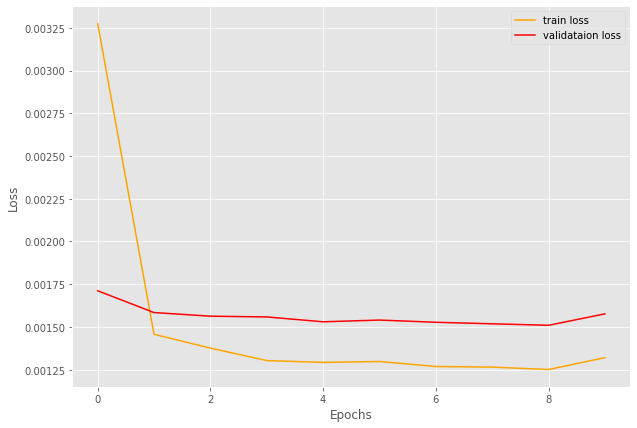

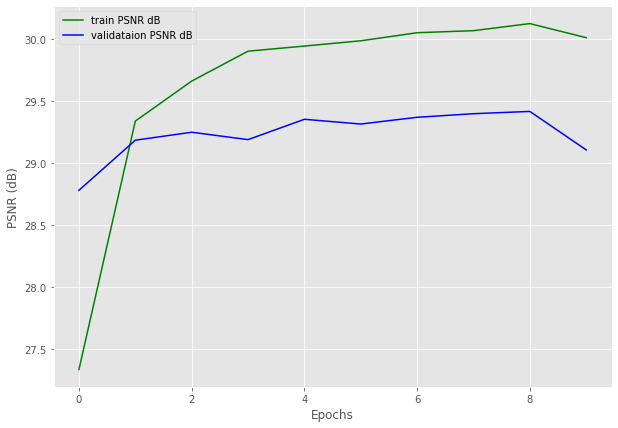

Saving model...


In [ ]:
# # loss plots
# plt.figure(figsize=(10, 7))
# plt.plot(train_loss, color='orange', label='train loss')
# plt.plot(val_loss, color='red', label='validataion loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()

# plt.show()
# # psnr plots
# plt.figure(figsize=(10, 7))
# plt.plot(train_psnr, color='green', label='train PSNR dB')
# plt.plot(val_psnr, color='blue', label='validataion PSNR dB')
# plt.xlabel('Epochs')
# plt.ylabel('PSNR (dB)')
# plt.legend()

# plt.show()
# # save the model to disk
# print('Saving model...')
# torch.save(model.state_dict(), 'Bioimaging_data3/model.pth')

In [57]:
import torch
import cv2

import numpy as np
import glob as glob
import os
from torchvision.utils import save_image

In [58]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [59]:
device

'cuda'

In [60]:
saved_model = SRCNN().to(device)
saved_model.load_state_dict(torch.load('Bioimaging_data3/model.pth'))

<All keys matched successfully>

Test Images: Low Res, High Res, Predicted (PSNR: 38.01, SSIM: 0.99)


C:\Users\amant\AppData\Local\Temp/ipykernel_17056/2725603127.py:33: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  ssim_val = ssim(test_high_image, output, multichannel=True)


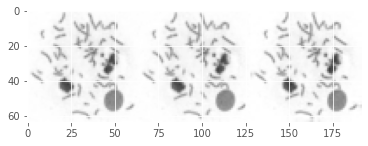

Test Images: Low Res, High Res, Predicted (PSNR: 30.24, SSIM: 0.98)


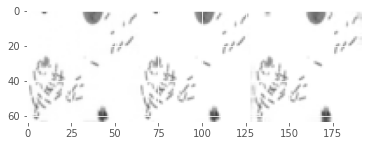

Test Images: Low Res, High Res, Predicted (PSNR: 31.09, SSIM: 0.98)


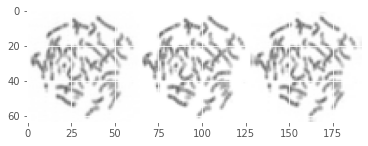

Test Images: Low Res, High Res, Predicted (PSNR: 31.95, SSIM: 0.98)


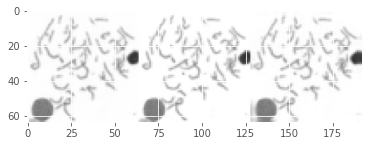

Test Images: Low Res, High Res, Predicted (PSNR: 34.33, SSIM: 0.99)


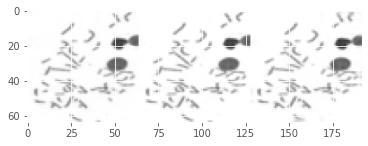

Test Images: Low Res, High Res, Predicted (PSNR: 31.61, SSIM: 0.98)


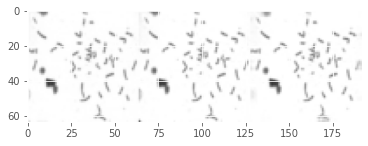

Test Images: Low Res, High Res, Predicted (PSNR: 33.22, SSIM: 0.98)


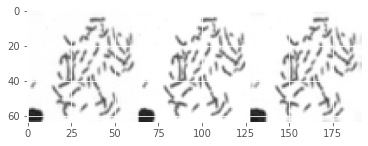

Test Images: Low Res, High Res, Predicted (PSNR: 30.22, SSIM: 0.97)


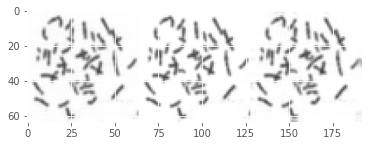

Test Images: Low Res, High Res, Predicted (PSNR: 31.38, SSIM: 0.99)


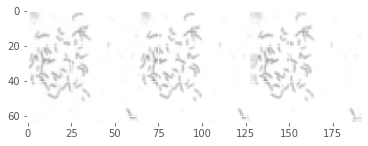

Test Images: Low Res, High Res, Predicted (PSNR: 30.29, SSIM: 0.97)


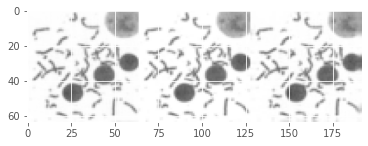

Test Images: Low Res, High Res, Predicted (PSNR: 33.44, SSIM: 0.98)


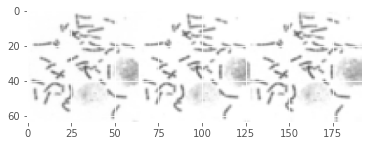

Test Images: Low Res, High Res, Predicted (PSNR: 31.61, SSIM: 0.98)


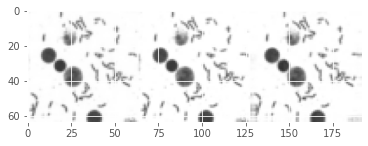

Test Images: Low Res, High Res, Predicted (PSNR: 28.29, SSIM: 0.98)


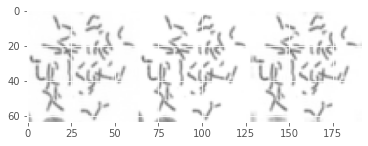

Test Images: Low Res, High Res, Predicted (PSNR: 36.89, SSIM: 0.99)


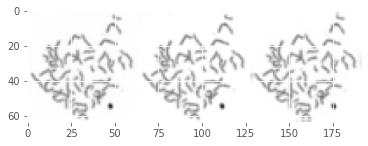

Test Images: Low Res, High Res, Predicted (PSNR: 30.18, SSIM: 0.96)


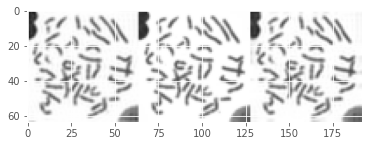

Test Images: Low Res, High Res, Predicted (PSNR: 33.20, SSIM: 0.98)


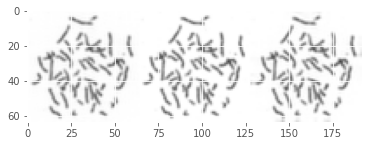

Test Images: Low Res, High Res, Predicted (PSNR: 31.48, SSIM: 0.99)


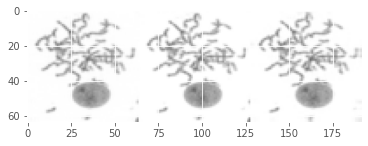

Test Images: Low Res, High Res, Predicted (PSNR: 30.99, SSIM: 0.99)


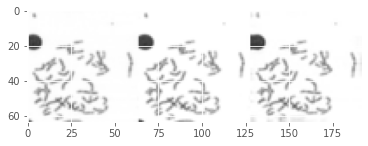

Test Images: Low Res, High Res, Predicted (PSNR: 33.86, SSIM: 0.98)


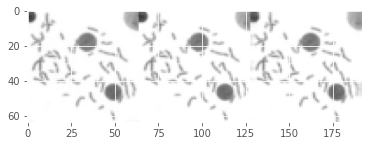

Test Images: Low Res, High Res, Predicted (PSNR: 29.83, SSIM: 0.98)


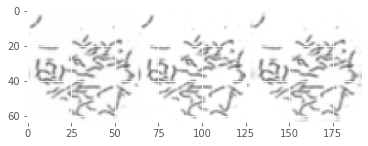

Test Images: Low Res, High Res, Predicted (PSNR: 36.99, SSIM: 0.99)


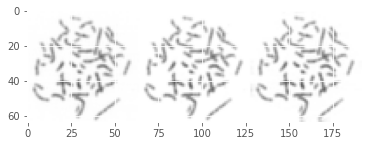

Test Images: Low Res, High Res, Predicted (PSNR: 33.59, SSIM: 0.99)


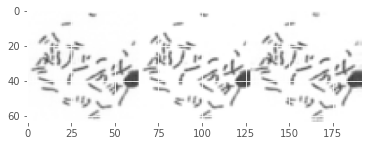

Test Images: Low Res, High Res, Predicted (PSNR: 29.70, SSIM: 0.98)


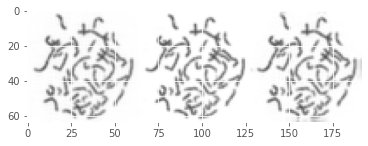

Test Images: Low Res, High Res, Predicted (PSNR: 29.71, SSIM: 0.97)


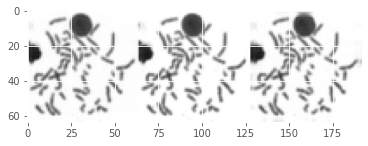

Test Images: Low Res, High Res, Predicted (PSNR: 32.54, SSIM: 0.97)


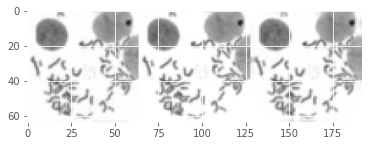

Test Images: Low Res, High Res, Predicted (PSNR: 26.00, SSIM: 0.96)


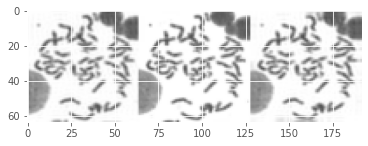

Test Images: Low Res, High Res, Predicted (PSNR: 32.01, SSIM: 0.98)


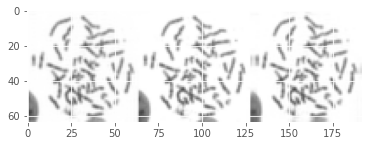

Test Images: Low Res, High Res, Predicted (PSNR: 29.40, SSIM: 0.98)


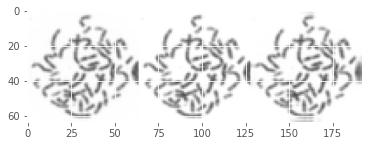

Test Images: Low Res, High Res, Predicted (PSNR: 32.66, SSIM: 0.98)


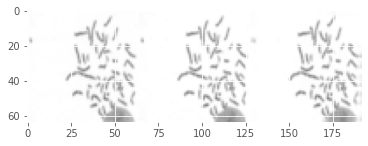

Test Images: Low Res, High Res, Predicted (PSNR: 34.91, SSIM: 0.99)


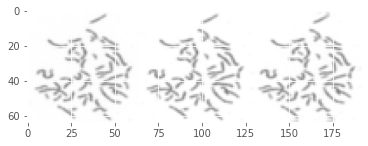

Test Images: Low Res, High Res, Predicted (PSNR: 31.86, SSIM: 0.98)


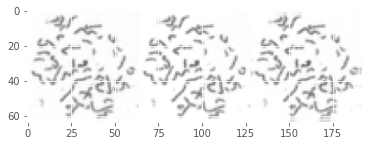

Test Images: Low Res, High Res, Predicted (PSNR: 28.31, SSIM: 0.97)


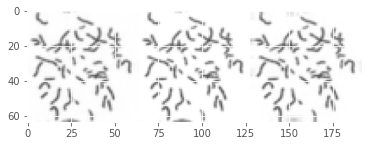

Test Images: Low Res, High Res, Predicted (PSNR: 36.60, SSIM: 0.99)


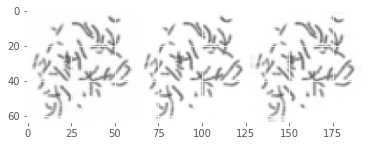

Test Images: Low Res, High Res, Predicted (PSNR: 28.95, SSIM: 0.97)


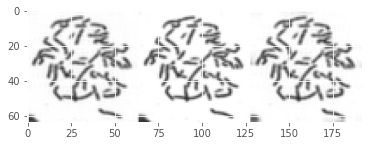

Test Images: Low Res, High Res, Predicted (PSNR: 27.33, SSIM: 0.97)


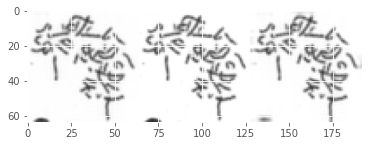

Test Images: Low Res, High Res, Predicted (PSNR: 30.69, SSIM: 0.97)


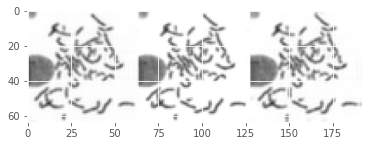

Test Images: Low Res, High Res, Predicted (PSNR: 28.05, SSIM: 0.98)


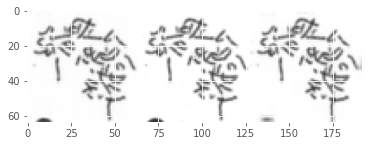

Test Images: Low Res, High Res, Predicted (PSNR: 30.95, SSIM: 0.98)


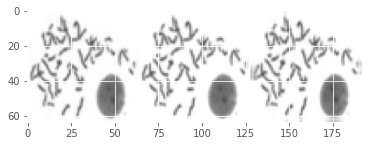

Test Images: Low Res, High Res, Predicted (PSNR: 29.98, SSIM: 0.98)


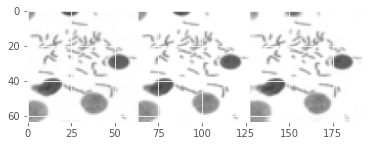

Test Images: Low Res, High Res, Predicted (PSNR: 30.69, SSIM: 0.99)


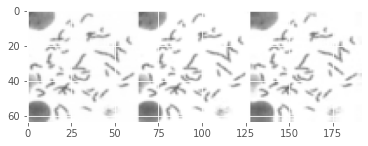

Test Images: Low Res, High Res, Predicted (PSNR: 35.13, SSIM: 0.99)


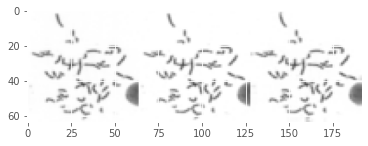

Test Images: Low Res, High Res, Predicted (PSNR: 32.27, SSIM: 0.98)


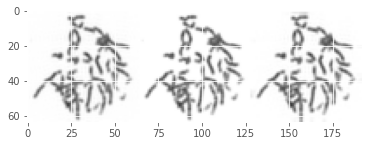

Test Images: Low Res, High Res, Predicted (PSNR: 28.23, SSIM: 0.97)


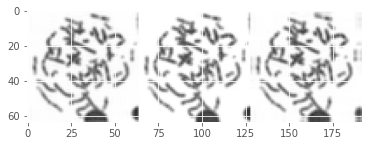

Test Images: Low Res, High Res, Predicted (PSNR: 30.03, SSIM: 0.99)


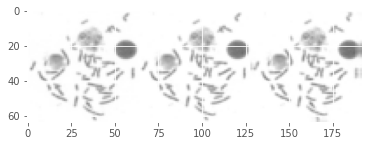

Test Images: Low Res, High Res, Predicted (PSNR: 33.85, SSIM: 0.99)


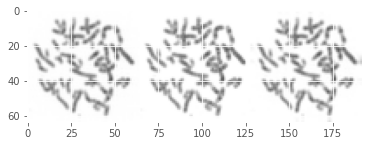

Test Images: Low Res, High Res, Predicted (PSNR: 27.36, SSIM: 0.98)


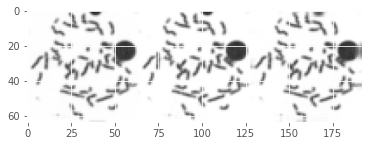

Test Images: Low Res, High Res, Predicted (PSNR: 32.47, SSIM: 0.99)


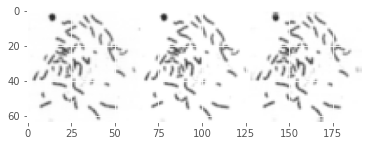

Test Images: Low Res, High Res, Predicted (PSNR: 33.41, SSIM: 0.98)


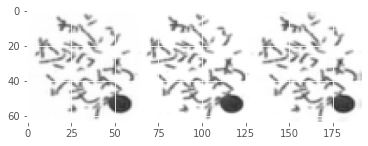

Test Images: Low Res, High Res, Predicted (PSNR: 29.96, SSIM: 0.97)


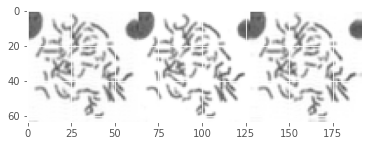

Test Images: Low Res, High Res, Predicted (PSNR: 27.50, SSIM: 0.98)


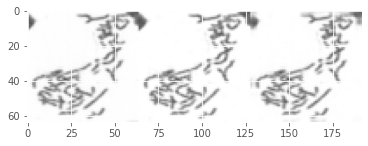

Test Images: Low Res, High Res, Predicted (PSNR: 32.17, SSIM: 0.98)


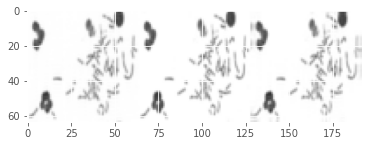

Test Images: Low Res, High Res, Predicted (PSNR: 25.41, SSIM: 0.97)


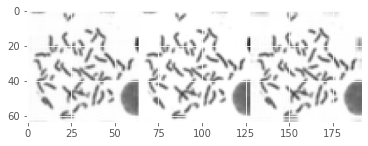

Test Images: Low Res, High Res, Predicted (PSNR: 32.24, SSIM: 0.98)


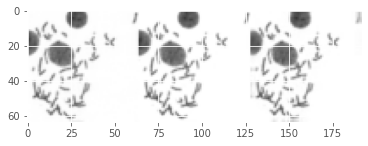

Test Images: Low Res, High Res, Predicted (PSNR: 33.87, SSIM: 0.99)


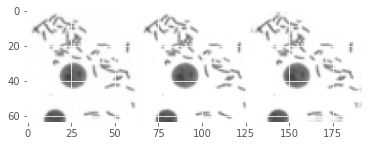

Test Images: Low Res, High Res, Predicted (PSNR: 30.87, SSIM: 0.99)


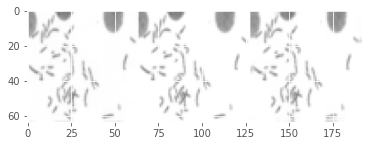

Test Images: Low Res, High Res, Predicted (PSNR: 31.19, SSIM: 0.98)


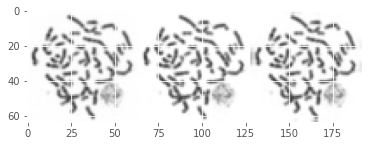

Test Images: Low Res, High Res, Predicted (PSNR: 31.81, SSIM: 0.98)


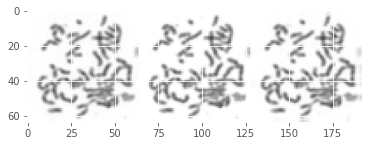

Test Images: Low Res, High Res, Predicted (PSNR: 37.89, SSIM: 0.99)


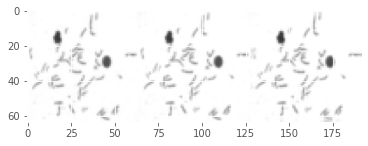

Test Images: Low Res, High Res, Predicted (PSNR: 30.47, SSIM: 0.99)


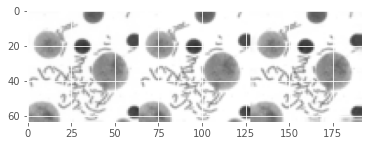

Test Images: Low Res, High Res, Predicted (PSNR: 34.65, SSIM: 0.99)


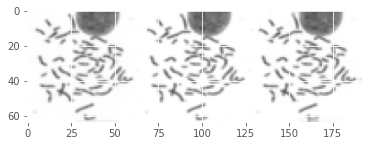

Test Images: Low Res, High Res, Predicted (PSNR: 31.32, SSIM: 0.99)


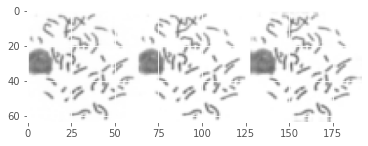

Test Images: Low Res, High Res, Predicted (PSNR: 33.81, SSIM: 0.99)


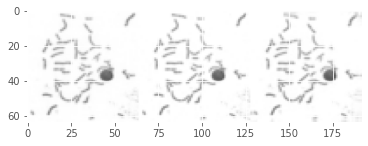

Test Images: Low Res, High Res, Predicted (PSNR: 30.14, SSIM: 0.98)


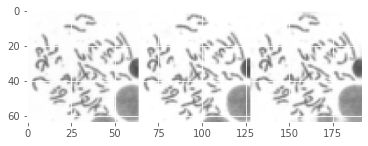

Test Images: Low Res, High Res, Predicted (PSNR: 28.52, SSIM: 0.97)


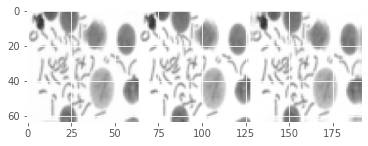

Test Images: Low Res, High Res, Predicted (PSNR: 26.70, SSIM: 0.98)


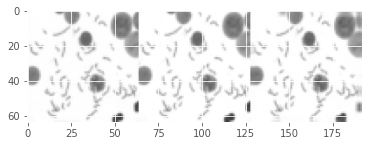

Test Images: Low Res, High Res, Predicted (PSNR: 25.26, SSIM: 0.98)


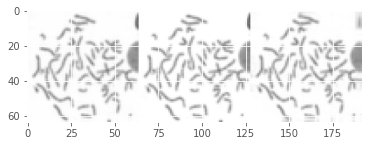

Test Images: Low Res, High Res, Predicted (PSNR: 31.70, SSIM: 0.98)


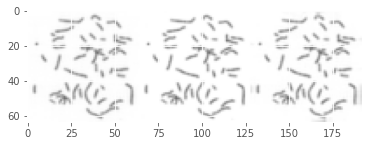

Test Images: Low Res, High Res, Predicted (PSNR: 34.92, SSIM: 0.99)


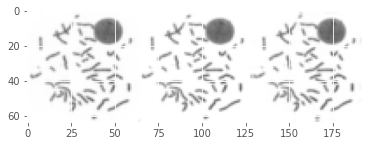

Test Images: Low Res, High Res, Predicted (PSNR: 31.35, SSIM: 0.98)


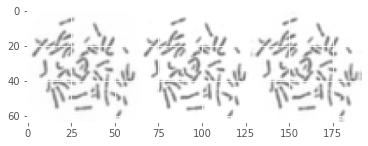

Test Images: Low Res, High Res, Predicted (PSNR: 28.90, SSIM: 0.98)


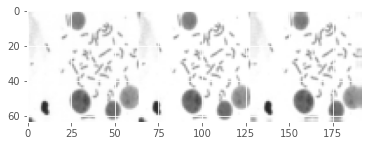

Test Images: Low Res, High Res, Predicted (PSNR: 31.73, SSIM: 0.99)


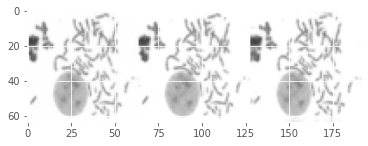

Test Images: Low Res, High Res, Predicted (PSNR: 32.61, SSIM: 0.98)


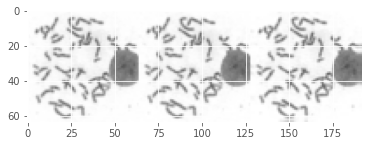

Test Images: Low Res, High Res, Predicted (PSNR: 30.97, SSIM: 0.98)


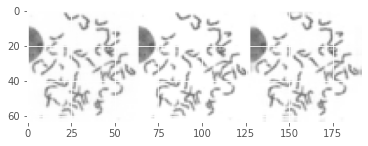

Test Images: Low Res, High Res, Predicted (PSNR: 31.39, SSIM: 0.98)


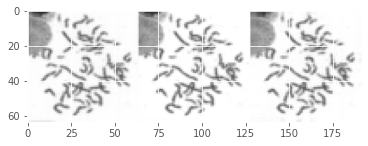

Test Images: Low Res, High Res, Predicted (PSNR: 30.90, SSIM: 0.98)


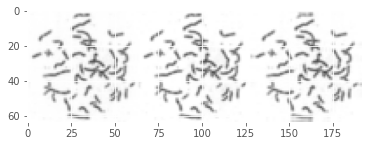

Test Images: Low Res, High Res, Predicted (PSNR: 29.79, SSIM: 0.98)


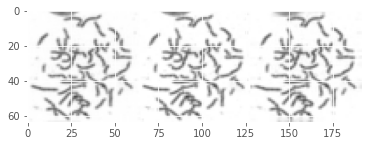

Test Images: Low Res, High Res, Predicted (PSNR: 32.11, SSIM: 0.98)


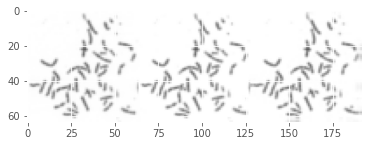

Test Images: Low Res, High Res, Predicted (PSNR: 37.79, SSIM: 0.99)


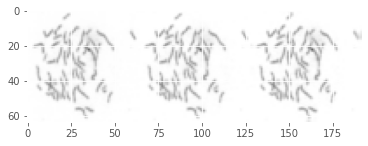

Test Images: Low Res, High Res, Predicted (PSNR: 38.27, SSIM: 1.00)


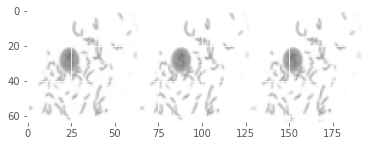

Test Images: Low Res, High Res, Predicted (PSNR: 33.43, SSIM: 0.98)


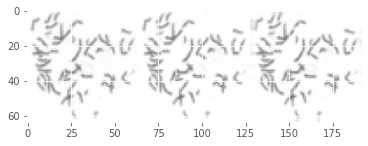

Test Images: Low Res, High Res, Predicted (PSNR: 34.82, SSIM: 0.98)


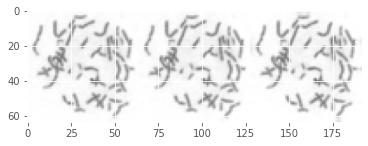

Test Images: Low Res, High Res, Predicted (PSNR: 34.19, SSIM: 0.98)


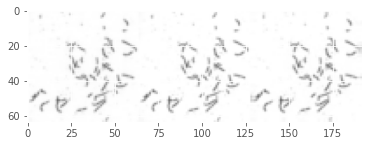

Test Images: Low Res, High Res, Predicted (PSNR: 30.02, SSIM: 0.98)


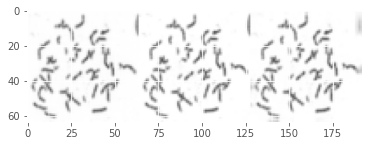

Test Images: Low Res, High Res, Predicted (PSNR: 34.16, SSIM: 0.98)


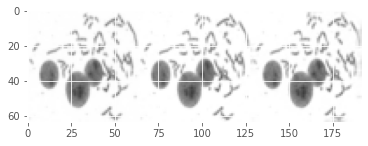

Test Images: Low Res, High Res, Predicted (PSNR: 34.25, SSIM: 0.99)


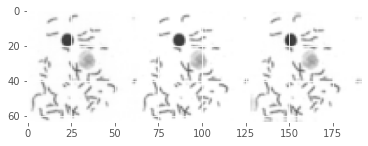

Test Images: Low Res, High Res, Predicted (PSNR: 27.54, SSIM: 0.98)


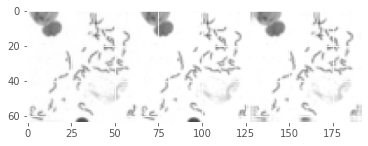

Test Images: Low Res, High Res, Predicted (PSNR: 33.68, SSIM: 0.99)


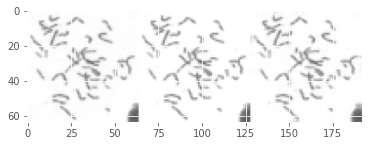

Test Images: Low Res, High Res, Predicted (PSNR: 31.75, SSIM: 0.99)


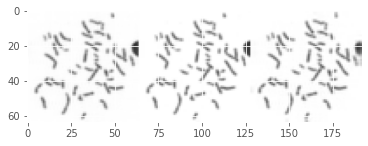

Test Images: Low Res, High Res, Predicted (PSNR: 32.71, SSIM: 0.98)


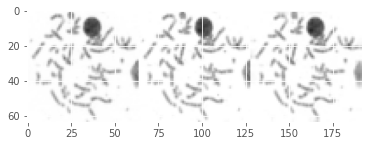

Test Images: Low Res, High Res, Predicted (PSNR: 28.59, SSIM: 0.98)


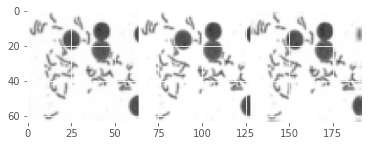

Test Images: Low Res, High Res, Predicted (PSNR: 31.92, SSIM: 0.99)


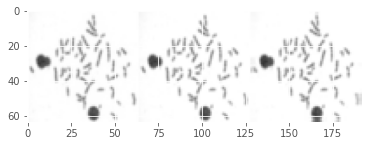

Test Images: Low Res, High Res, Predicted (PSNR: 37.64, SSIM: 0.99)


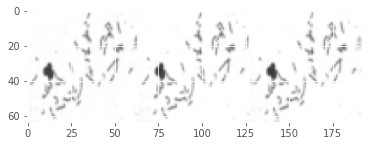

Test Images: Low Res, High Res, Predicted (PSNR: 33.33, SSIM: 0.99)


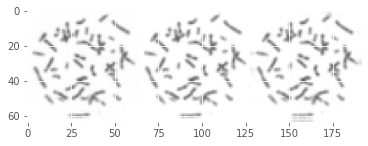

Test Images: Low Res, High Res, Predicted (PSNR: 29.48, SSIM: 0.97)


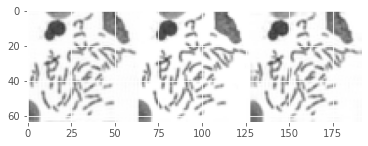

Test Images: Low Res, High Res, Predicted (PSNR: 29.95, SSIM: 0.98)


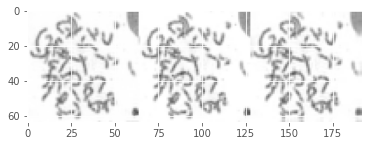

Test Images: Low Res, High Res, Predicted (PSNR: 32.60, SSIM: 0.99)


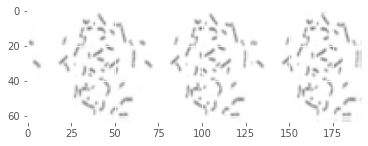

Test Images: Low Res, High Res, Predicted (PSNR: 28.65, SSIM: 0.99)


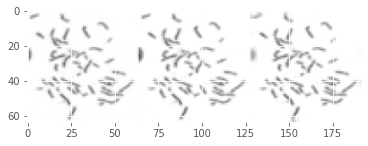

Test Images: Low Res, High Res, Predicted (PSNR: 35.42, SSIM: 0.99)


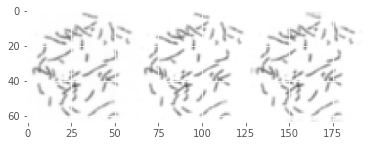

Test Images: Low Res, High Res, Predicted (PSNR: 34.70, SSIM: 0.99)


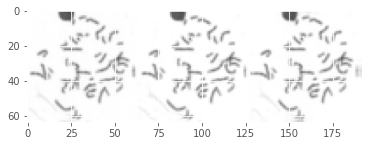

Test Images: Low Res, High Res, Predicted (PSNR: 34.52, SSIM: 0.99)


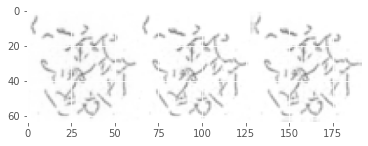

Test Images: Low Res, High Res, Predicted (PSNR: 31.28, SSIM: 0.98)


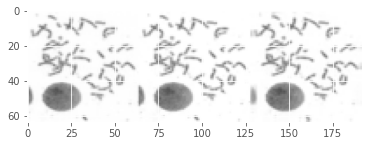

Test Images: Low Res, High Res, Predicted (PSNR: 30.74, SSIM: 0.97)


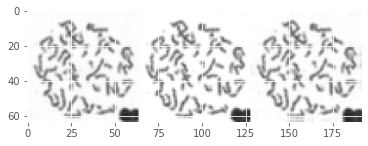

Test Images: Low Res, High Res, Predicted (PSNR: 29.39, SSIM: 0.98)


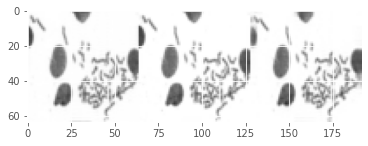

Test Images: Low Res, High Res, Predicted (PSNR: 34.29, SSIM: 0.99)


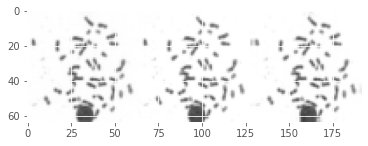

Test Images: Low Res, High Res, Predicted (PSNR: 31.77, SSIM: 0.98)


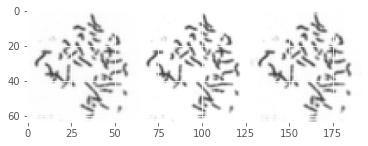

Test Images: Low Res, High Res, Predicted (PSNR: 30.87, SSIM: 0.98)


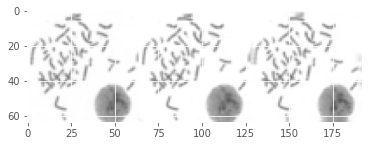

Test Images: Low Res, High Res, Predicted (PSNR: 30.73, SSIM: 0.99)


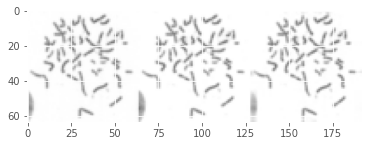

Test Images: Low Res, High Res, Predicted (PSNR: 32.86, SSIM: 0.99)


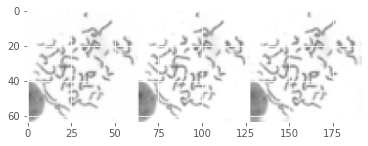

Test Images: Low Res, High Res, Predicted (PSNR: 30.23, SSIM: 0.98)


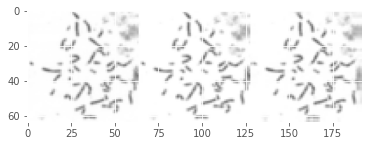

Test Images: Low Res, High Res, Predicted (PSNR: 31.33, SSIM: 0.98)


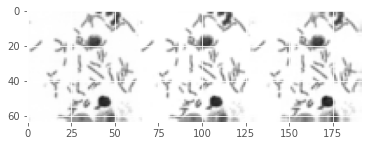

Test Images: Low Res, High Res, Predicted (PSNR: 28.94, SSIM: 0.99)


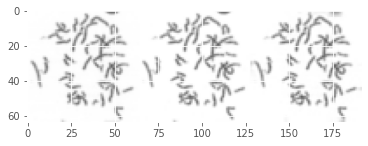

Test Images: Low Res, High Res, Predicted (PSNR: 32.44, SSIM: 0.98)


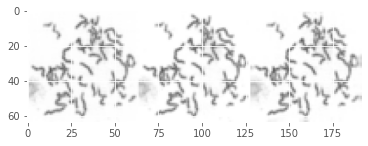

Test Images: Low Res, High Res, Predicted (PSNR: 31.98, SSIM: 0.99)


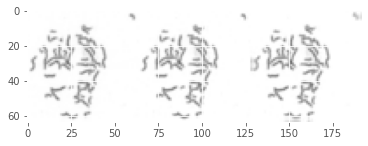

Test Images: Low Res, High Res, Predicted (PSNR: 30.61, SSIM: 0.99)


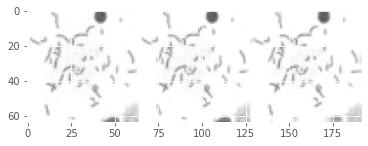

Test Images: Low Res, High Res, Predicted (PSNR: 27.21, SSIM: 0.97)


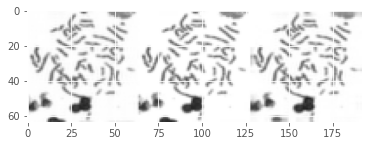

Test Images: Low Res, High Res, Predicted (PSNR: 34.21, SSIM: 0.99)


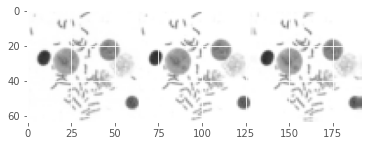

Test Images: Low Res, High Res, Predicted (PSNR: 27.96, SSIM: 0.97)


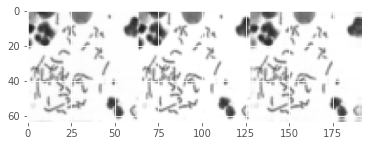

Test Images: Low Res, High Res, Predicted (PSNR: 27.47, SSIM: 0.97)


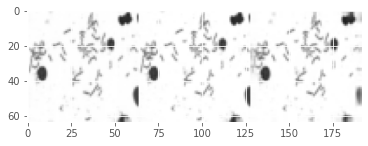

Test Images: Low Res, High Res, Predicted (PSNR: 33.36, SSIM: 0.98)


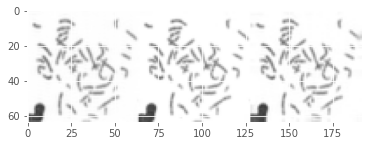

Test Images: Low Res, High Res, Predicted (PSNR: 30.18, SSIM: 0.98)


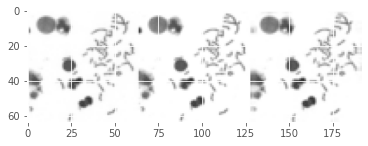

Test Images: Low Res, High Res, Predicted (PSNR: 31.90, SSIM: 0.98)


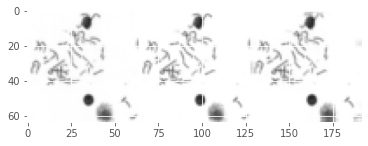

Test Images: Low Res, High Res, Predicted (PSNR: 35.22, SSIM: 0.99)


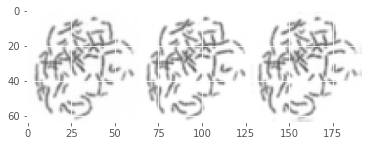

Test Images: Low Res, High Res, Predicted (PSNR: 32.78, SSIM: 0.98)


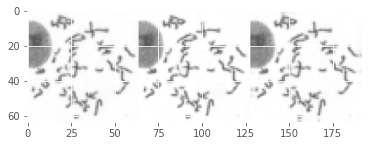

Test Images: Low Res, High Res, Predicted (PSNR: 34.13, SSIM: 0.99)


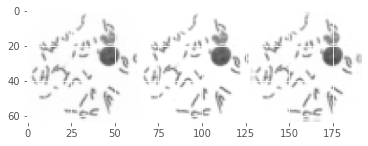

Test Images: Low Res, High Res, Predicted (PSNR: 32.87, SSIM: 0.99)


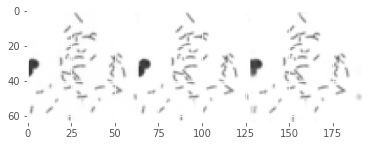

Test Images: Low Res, High Res, Predicted (PSNR: 34.14, SSIM: 0.99)


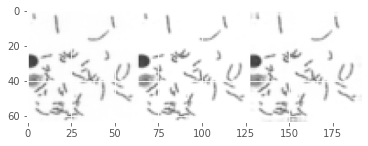

Test Images: Low Res, High Res, Predicted (PSNR: 28.64, SSIM: 0.98)


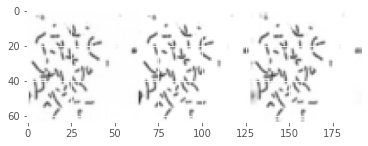

Test Images: Low Res, High Res, Predicted (PSNR: 29.20, SSIM: 0.98)


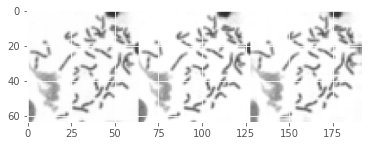

Test Images: Low Res, High Res, Predicted (PSNR: 35.17, SSIM: 0.99)


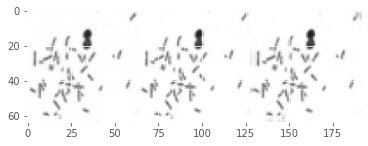

Test Images: Low Res, High Res, Predicted (PSNR: 30.58, SSIM: 0.98)


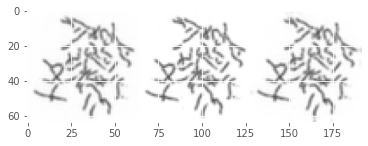

Test Images: Low Res, High Res, Predicted (PSNR: 31.10, SSIM: 0.98)


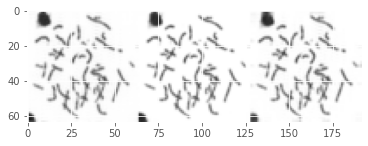

Test Images: Low Res, High Res, Predicted (PSNR: 31.64, SSIM: 0.99)


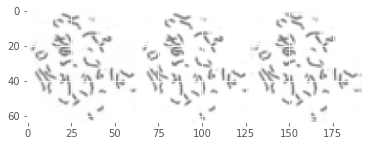

Test Images: Low Res, High Res, Predicted (PSNR: 35.60, SSIM: 0.98)


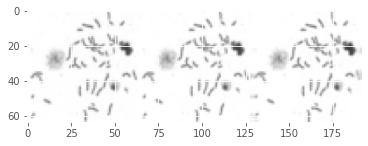

Test Images: Low Res, High Res, Predicted (PSNR: 34.32, SSIM: 0.99)


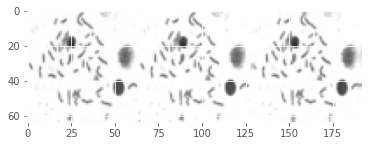

Test Images: Low Res, High Res, Predicted (PSNR: 32.35, SSIM: 0.98)


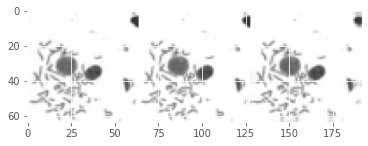

Test Images: Low Res, High Res, Predicted (PSNR: 32.19, SSIM: 0.98)


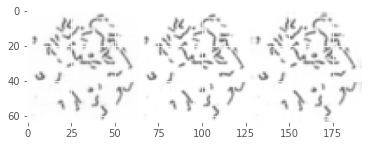

Test Images: Low Res, High Res, Predicted (PSNR: 28.55, SSIM: 0.97)


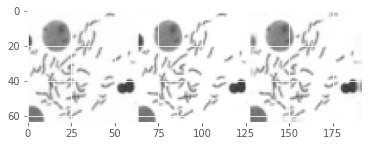

Test Images: Low Res, High Res, Predicted (PSNR: 32.87, SSIM: 0.99)


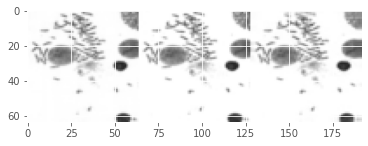

Test Images: Low Res, High Res, Predicted (PSNR: 31.81, SSIM: 0.98)


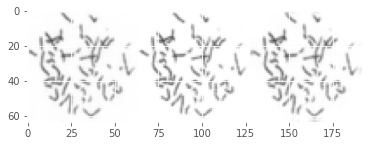

Test Images: Low Res, High Res, Predicted (PSNR: 27.83, SSIM: 0.96)


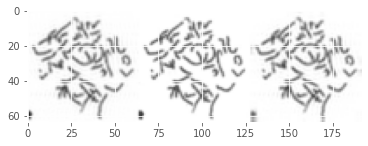

Test Images: Low Res, High Res, Predicted (PSNR: 33.36, SSIM: 0.98)


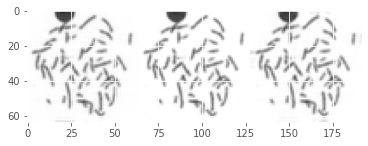

Test Images: Low Res, High Res, Predicted (PSNR: 32.44, SSIM: 0.98)


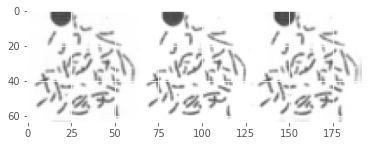

Test Images: Low Res, High Res, Predicted (PSNR: 29.71, SSIM: 0.97)


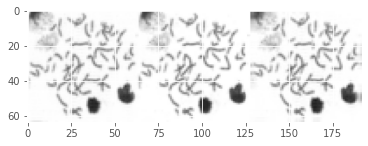

Test Images: Low Res, High Res, Predicted (PSNR: 33.73, SSIM: 0.98)


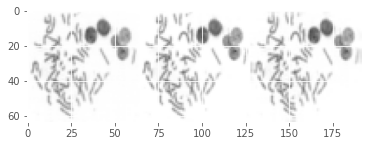

Test Images: Low Res, High Res, Predicted (PSNR: 33.77, SSIM: 0.99)


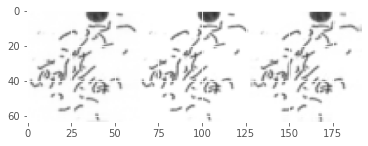

Test Images: Low Res, High Res, Predicted (PSNR: 34.24, SSIM: 0.99)


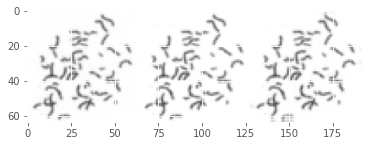

Test Images: Low Res, High Res, Predicted (PSNR: 33.76, SSIM: 0.99)


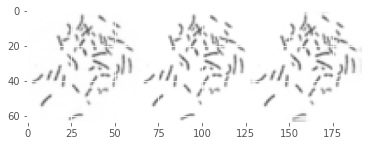

Test Images: Low Res, High Res, Predicted (PSNR: 32.06, SSIM: 0.98)


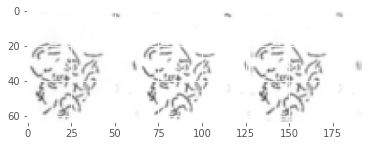

Test Images: Low Res, High Res, Predicted (PSNR: 31.42, SSIM: 0.97)


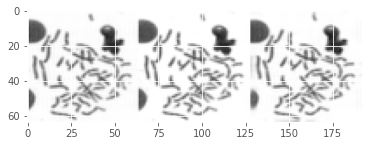

Test Images: Low Res, High Res, Predicted (PSNR: 34.38, SSIM: 0.98)


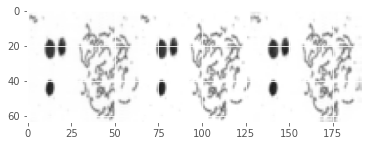

Test Images: Low Res, High Res, Predicted (PSNR: 29.85, SSIM: 0.98)


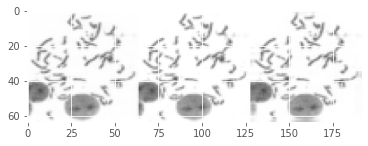

Test Images: Low Res, High Res, Predicted (PSNR: 32.05, SSIM: 0.97)


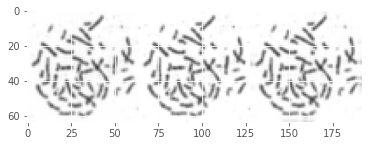

Test Images: Low Res, High Res, Predicted (PSNR: 31.40, SSIM: 0.98)


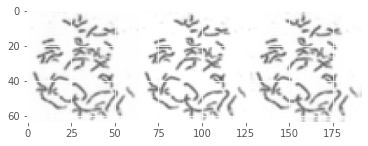

Test Images: Low Res, High Res, Predicted (PSNR: 31.19, SSIM: 0.97)


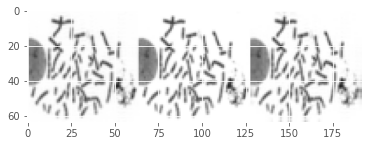

Test Images: Low Res, High Res, Predicted (PSNR: 30.10, SSIM: 0.98)


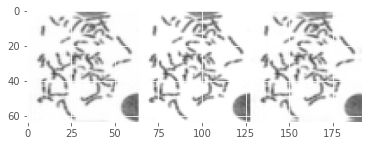

Test Images: Low Res, High Res, Predicted (PSNR: 29.81, SSIM: 0.98)


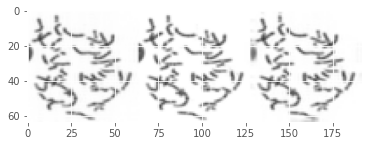

Test Images: Low Res, High Res, Predicted (PSNR: 30.83, SSIM: 0.98)


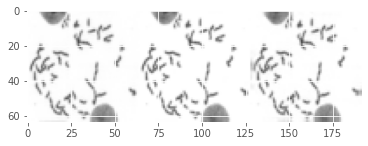

Test Images: Low Res, High Res, Predicted (PSNR: 32.99, SSIM: 0.98)


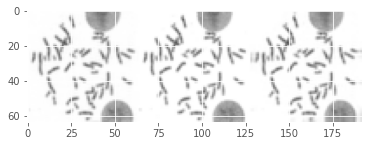

Test Images: Low Res, High Res, Predicted (PSNR: 30.57, SSIM: 0.98)


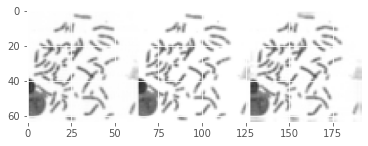

Test Images: Low Res, High Res, Predicted (PSNR: 31.12, SSIM: 0.99)


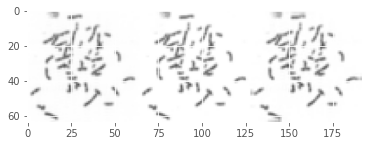

Test Images: Low Res, High Res, Predicted (PSNR: 29.68, SSIM: 0.98)


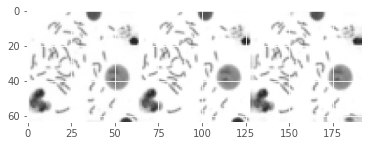

Test Images: Low Res, High Res, Predicted (PSNR: 31.21, SSIM: 0.98)


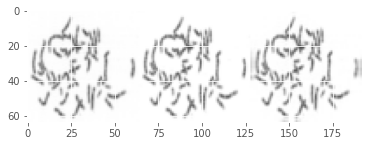

Test Images: Low Res, High Res, Predicted (PSNR: 35.76, SSIM: 0.99)


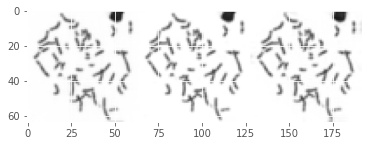

Test Images: Low Res, High Res, Predicted (PSNR: 27.22, SSIM: 0.98)


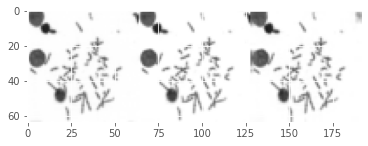

Test Images: Low Res, High Res, Predicted (PSNR: 31.07, SSIM: 0.98)


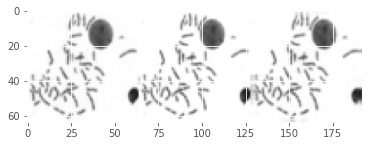

Test Images: Low Res, High Res, Predicted (PSNR: 33.69, SSIM: 0.98)


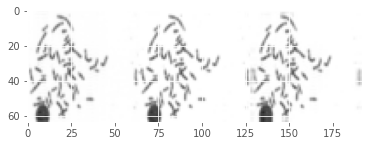

Test Images: Low Res, High Res, Predicted (PSNR: 32.72, SSIM: 0.99)


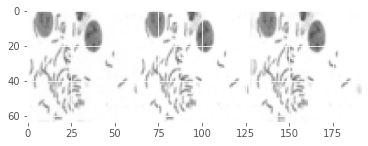

Test Images: Low Res, High Res, Predicted (PSNR: 30.14, SSIM: 0.98)


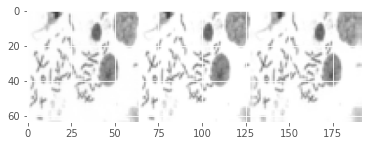

Test Images: Low Res, High Res, Predicted (PSNR: 30.11, SSIM: 0.97)


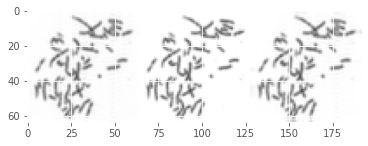

Test Images: Low Res, High Res, Predicted (PSNR: 33.01, SSIM: 0.98)


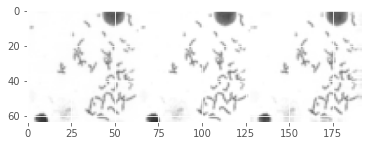

Test Images: Low Res, High Res, Predicted (PSNR: 27.80, SSIM: 0.98)


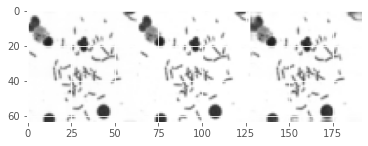

Test Images: Low Res, High Res, Predicted (PSNR: 31.64, SSIM: 0.99)


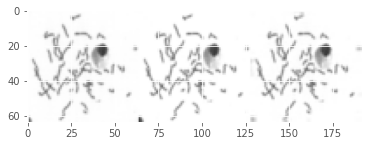

Test Images: Low Res, High Res, Predicted (PSNR: 35.98, SSIM: 0.99)


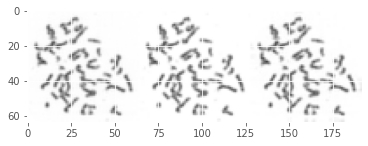

Test Images: Low Res, High Res, Predicted (PSNR: 30.33, SSIM: 0.98)


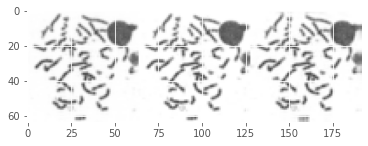

Test Images: Low Res, High Res, Predicted (PSNR: 31.31, SSIM: 0.99)


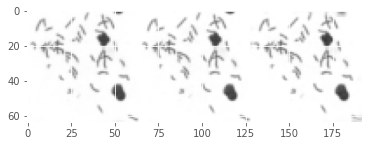

Test Images: Low Res, High Res, Predicted (PSNR: 28.97, SSIM: 0.99)


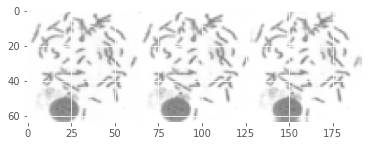

Test Images: Low Res, High Res, Predicted (PSNR: 34.85, SSIM: 0.99)


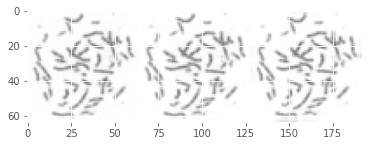

Test Images: Low Res, High Res, Predicted (PSNR: 33.06, SSIM: 0.98)


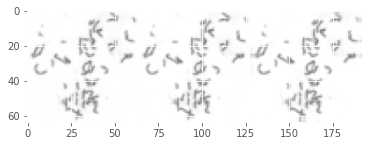

Test Images: Low Res, High Res, Predicted (PSNR: 32.15, SSIM: 0.97)


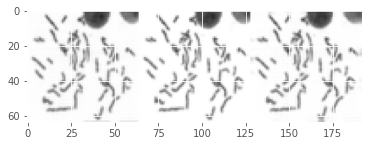

Test Images: Low Res, High Res, Predicted (PSNR: 33.33, SSIM: 0.99)


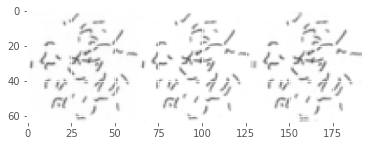

Test Images: Low Res, High Res, Predicted (PSNR: 31.21, SSIM: 0.97)


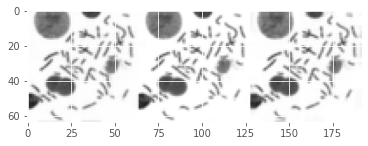

Test Images: Low Res, High Res, Predicted (PSNR: 29.80, SSIM: 0.98)


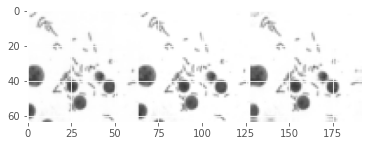

Test Images: Low Res, High Res, Predicted (PSNR: 28.66, SSIM: 0.97)


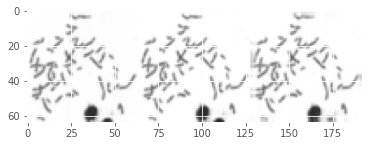

Test Images: Low Res, High Res, Predicted (PSNR: 29.61, SSIM: 0.97)


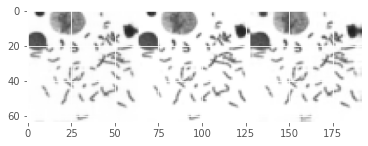

Test Images: Low Res, High Res, Predicted (PSNR: 34.99, SSIM: 0.99)


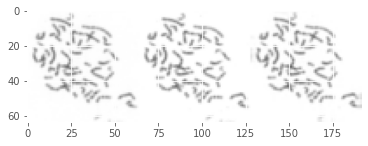

Test Images: Low Res, High Res, Predicted (PSNR: 33.20, SSIM: 0.99)


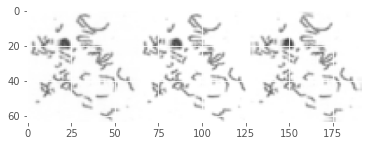

Test Images: Low Res, High Res, Predicted (PSNR: 30.24, SSIM: 0.98)


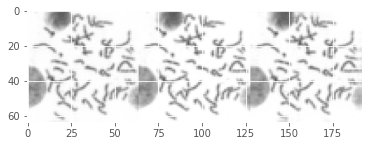

Test Images: Low Res, High Res, Predicted (PSNR: 30.38, SSIM: 0.98)


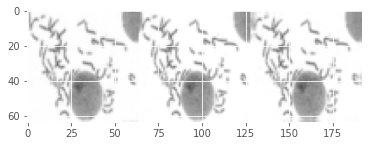

Test Images: Low Res, High Res, Predicted (PSNR: 34.02, SSIM: 0.99)


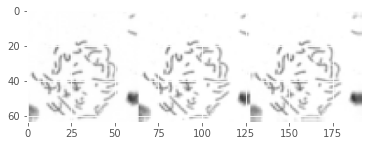

Test Images: Low Res, High Res, Predicted (PSNR: 33.40, SSIM: 0.99)


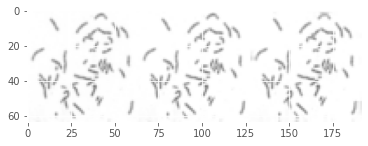

Test Images: Low Res, High Res, Predicted (PSNR: 33.62, SSIM: 0.98)


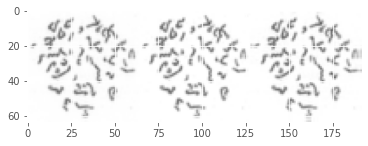

Test Images: Low Res, High Res, Predicted (PSNR: 32.90, SSIM: 0.98)


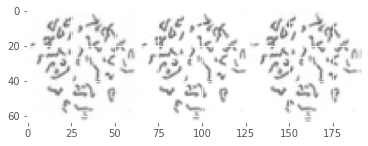

Test Images: Low Res, High Res, Predicted (PSNR: 33.22, SSIM: 0.98)


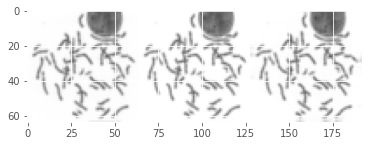

Test Images: Low Res, High Res, Predicted (PSNR: 33.33, SSIM: 0.99)


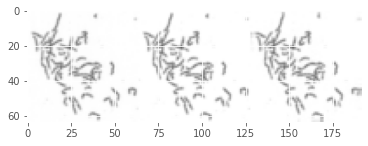

Test Images: Low Res, High Res, Predicted (PSNR: 35.51, SSIM: 0.99)


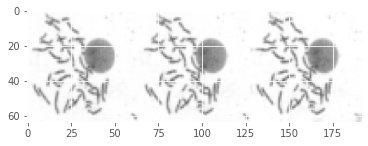

Test Images: Low Res, High Res, Predicted (PSNR: 30.51, SSIM: 0.98)


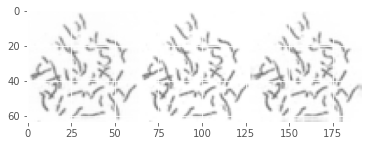

Test Images: Low Res, High Res, Predicted (PSNR: 31.03, SSIM: 0.98)


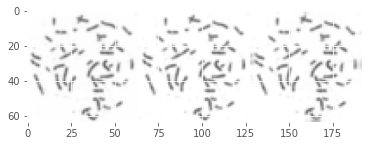

Test Images: Low Res, High Res, Predicted (PSNR: 33.91, SSIM: 0.99)


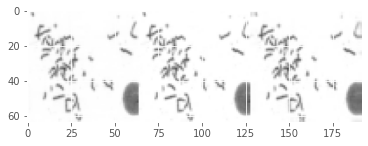

Test Images: Low Res, High Res, Predicted (PSNR: 33.50, SSIM: 0.99)


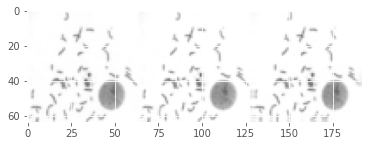

Test Images: Low Res, High Res, Predicted (PSNR: 30.47, SSIM: 0.99)


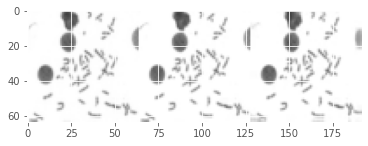

Test Images: Low Res, High Res, Predicted (PSNR: 35.21, SSIM: 0.99)


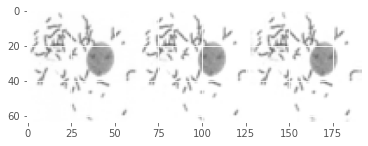

Test Images: Low Res, High Res, Predicted (PSNR: 31.08, SSIM: 0.99)


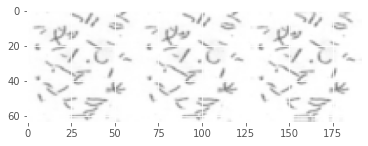

Test Images: Low Res, High Res, Predicted (PSNR: 32.09, SSIM: 0.99)


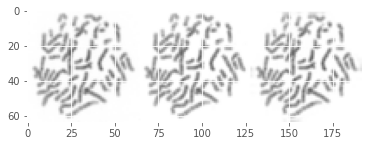

Test Images: Low Res, High Res, Predicted (PSNR: 37.02, SSIM: 0.99)


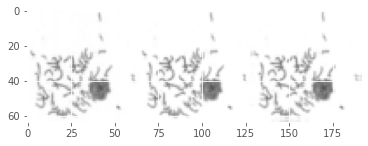

Test Images: Low Res, High Res, Predicted (PSNR: 29.07, SSIM: 0.97)


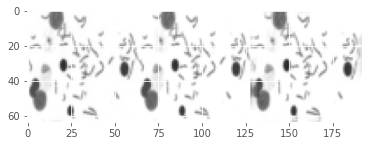

Test Images: Low Res, High Res, Predicted (PSNR: 36.19, SSIM: 0.99)


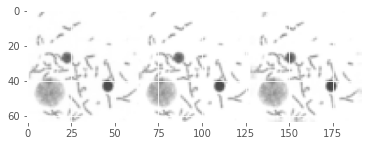

Test Images: Low Res, High Res, Predicted (PSNR: 35.71, SSIM: 0.98)


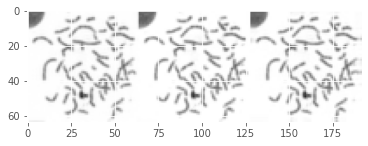

Test Images: Low Res, High Res, Predicted (PSNR: 32.26, SSIM: 0.99)


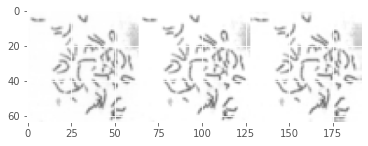

Test Images: Low Res, High Res, Predicted (PSNR: 31.05, SSIM: 0.97)


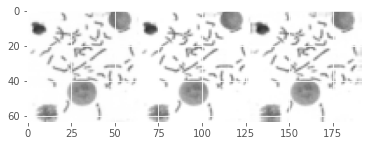

Test Images: Low Res, High Res, Predicted (PSNR: 28.45, SSIM: 0.98)


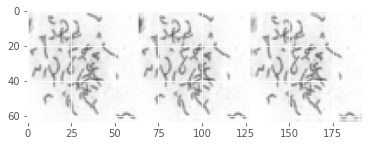

Test Images: Low Res, High Res, Predicted (PSNR: 28.70, SSIM: 0.98)


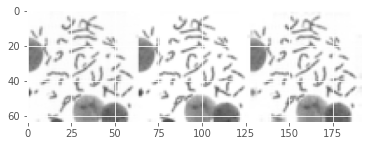

Test Images: Low Res, High Res, Predicted (PSNR: 27.08, SSIM: 0.97)


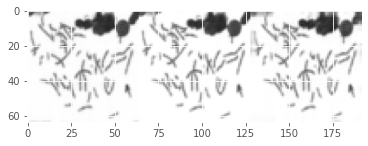

Test Images: Low Res, High Res, Predicted (PSNR: 28.88, SSIM: 0.98)


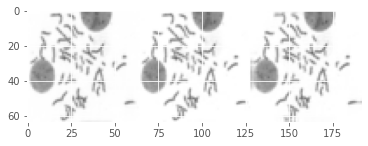

Test Images: Low Res, High Res, Predicted (PSNR: 32.83, SSIM: 0.99)


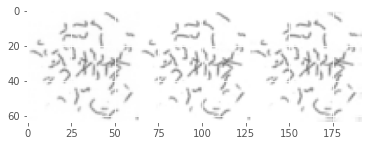

Test Images: Low Res, High Res, Predicted (PSNR: 29.30, SSIM: 0.98)


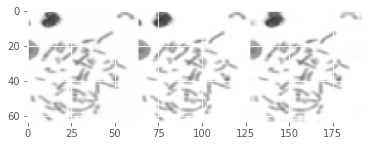

Test Images: Low Res, High Res, Predicted (PSNR: 30.56, SSIM: 0.99)


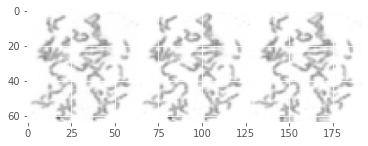

Test Images: Low Res, High Res, Predicted (PSNR: 35.26, SSIM: 0.99)


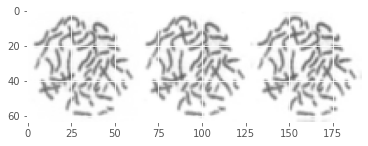

Test Images: Low Res, High Res, Predicted (PSNR: 29.25, SSIM: 0.99)


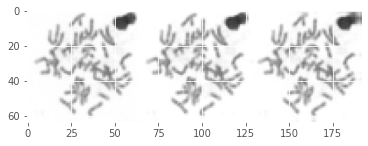

Test Images: Low Res, High Res, Predicted (PSNR: 33.33, SSIM: 0.98)


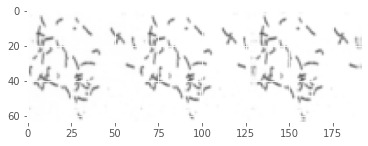

Test Images: Low Res, High Res, Predicted (PSNR: 32.86, SSIM: 0.99)


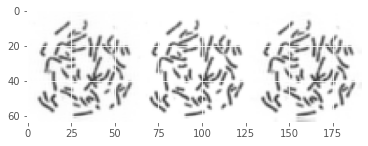

Test Images: Low Res, High Res, Predicted (PSNR: 29.08, SSIM: 0.97)


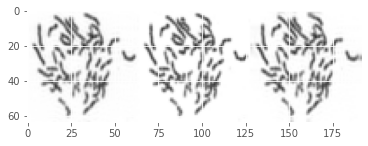

Test Images: Low Res, High Res, Predicted (PSNR: 31.34, SSIM: 0.98)


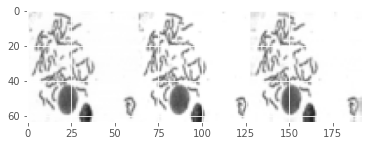

Test Images: Low Res, High Res, Predicted (PSNR: 33.85, SSIM: 0.99)


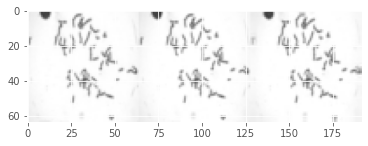

Test Images: Low Res, High Res, Predicted (PSNR: 32.16, SSIM: 0.98)


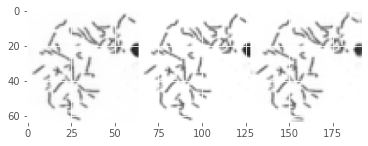

Test Images: Low Res, High Res, Predicted (PSNR: 31.42, SSIM: 0.98)


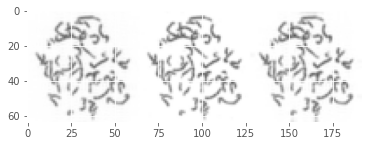

Test Images: Low Res, High Res, Predicted (PSNR: 26.69, SSIM: 0.98)


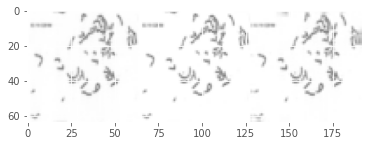

Test Images: Low Res, High Res, Predicted (PSNR: 34.19, SSIM: 0.99)


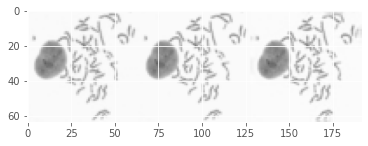

Test Images: Low Res, High Res, Predicted (PSNR: 29.71, SSIM: 0.98)


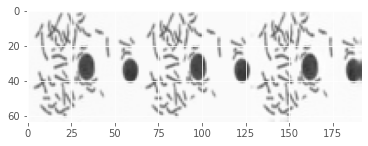

Test Images: Low Res, High Res, Predicted (PSNR: 38.99, SSIM: 0.99)


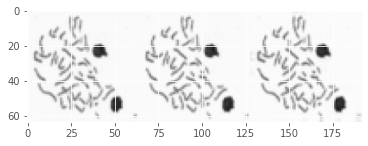

Test Images: Low Res, High Res, Predicted (PSNR: 29.83, SSIM: 0.98)


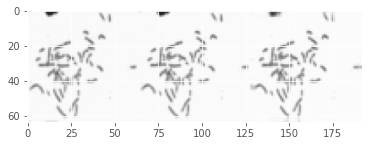

Test Images: Low Res, High Res, Predicted (PSNR: 34.61, SSIM: 0.98)


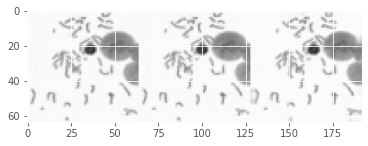

Test Images: Low Res, High Res, Predicted (PSNR: 30.51, SSIM: 0.98)


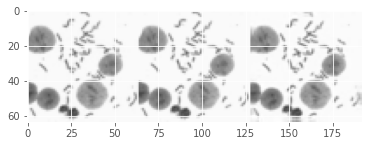

Test Images: Low Res, High Res, Predicted (PSNR: 35.72, SSIM: 0.99)


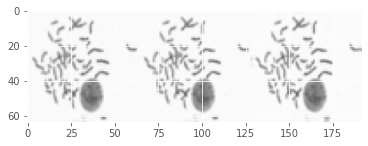

Test Images: Low Res, High Res, Predicted (PSNR: 33.09, SSIM: 0.98)


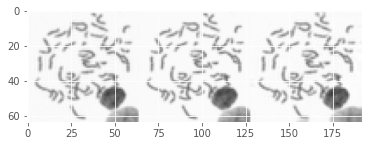

Test Images: Low Res, High Res, Predicted (PSNR: 32.32, SSIM: 0.98)


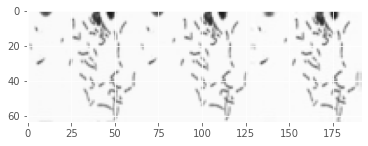

Test Images: Low Res, High Res, Predicted (PSNR: 32.51, SSIM: 0.98)


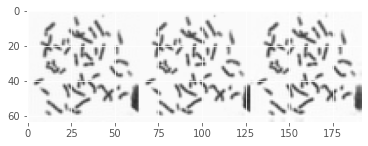

Test Images: Low Res, High Res, Predicted (PSNR: 33.78, SSIM: 0.98)


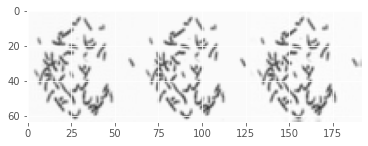

Test Images: Low Res, High Res, Predicted (PSNR: 34.51, SSIM: 0.99)


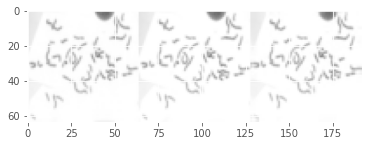

Test Images: Low Res, High Res, Predicted (PSNR: 36.76, SSIM: 0.99)


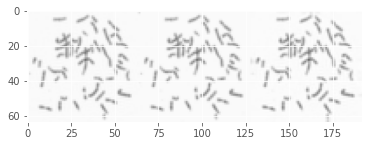

Test Images: Low Res, High Res, Predicted (PSNR: 28.29, SSIM: 0.98)


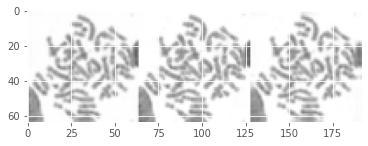

Test Images: Low Res, High Res, Predicted (PSNR: 32.75, SSIM: 0.98)


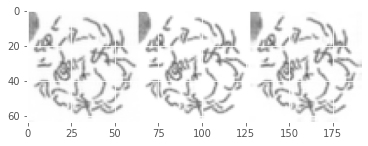

Test Images: Low Res, High Res, Predicted (PSNR: 34.35, SSIM: 0.99)


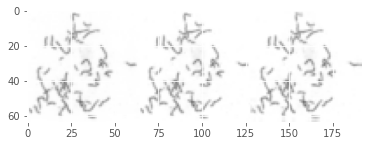

Test Images: Low Res, High Res, Predicted (PSNR: 36.65, SSIM: 0.99)


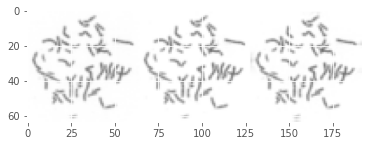

Test Images: Low Res, High Res, Predicted (PSNR: 31.28, SSIM: 0.98)


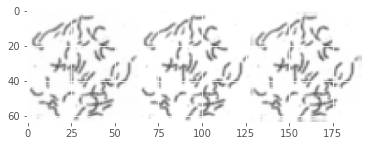

Test Images: Low Res, High Res, Predicted (PSNR: 34.20, SSIM: 0.99)


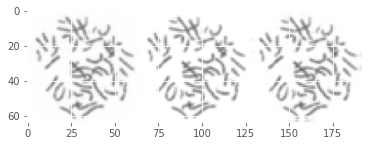

Test Images: Low Res, High Res, Predicted (PSNR: 29.15, SSIM: 0.98)


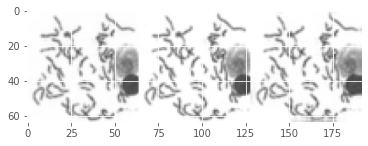

Test Images: Low Res, High Res, Predicted (PSNR: 33.40, SSIM: 0.98)


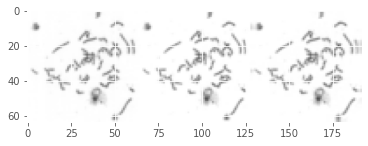

Test Images: Low Res, High Res, Predicted (PSNR: 28.64, SSIM: 0.99)


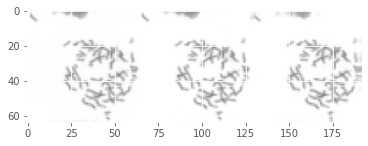

Test Images: Low Res, High Res, Predicted (PSNR: 30.60, SSIM: 0.97)


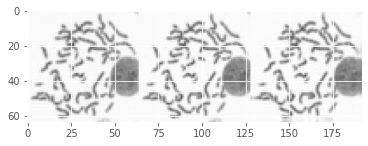

Test Images: Low Res, High Res, Predicted (PSNR: 34.47, SSIM: 0.98)


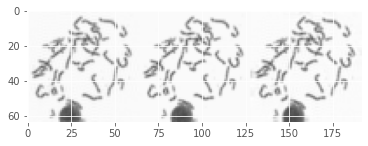

Test Images: Low Res, High Res, Predicted (PSNR: 33.98, SSIM: 0.98)


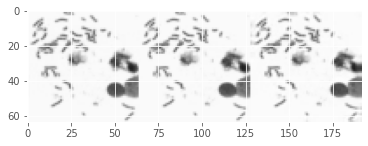

Test Images: Low Res, High Res, Predicted (PSNR: 35.42, SSIM: 0.99)


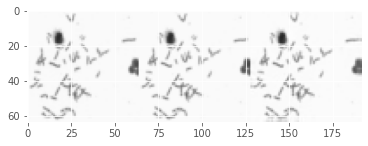

Test Images: Low Res, High Res, Predicted (PSNR: 33.11, SSIM: 0.98)


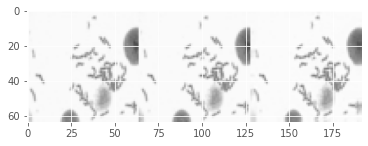

Test Images: Low Res, High Res, Predicted (PSNR: 31.09, SSIM: 0.96)


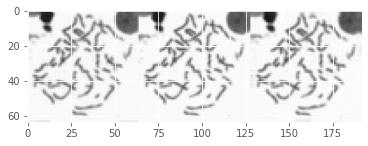

Test Images: Low Res, High Res, Predicted (PSNR: 33.86, SSIM: 0.98)


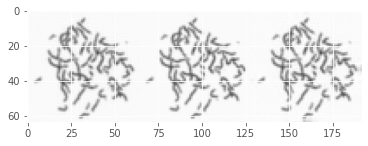

Test Images: Low Res, High Res, Predicted (PSNR: 37.56, SSIM: 0.98)


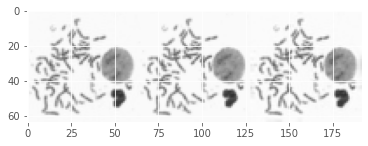

Test Images: Low Res, High Res, Predicted (PSNR: 34.05, SSIM: 0.99)


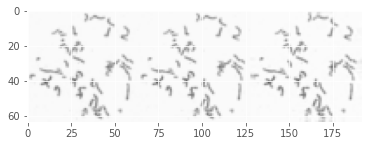

Test Images: Low Res, High Res, Predicted (PSNR: 33.26, SSIM: 0.99)


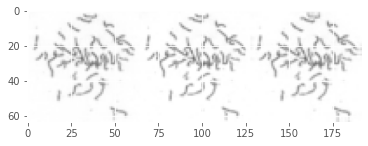

Test Images: Low Res, High Res, Predicted (PSNR: 32.61, SSIM: 0.98)


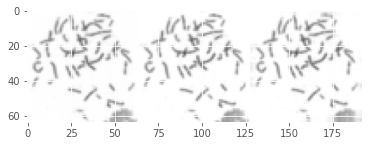

Test Images: Low Res, High Res, Predicted (PSNR: 34.75, SSIM: 0.98)


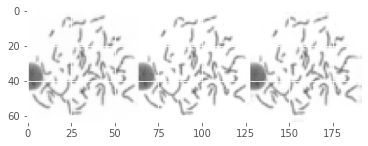

Test Images: Low Res, High Res, Predicted (PSNR: 36.12, SSIM: 0.99)


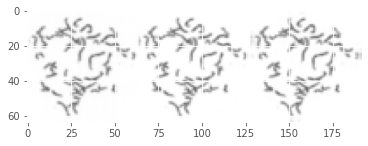

Test Images: Low Res, High Res, Predicted (PSNR: 31.58, SSIM: 0.98)


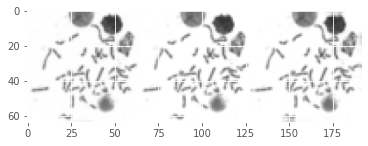

Test Images: Low Res, High Res, Predicted (PSNR: 35.93, SSIM: 0.99)


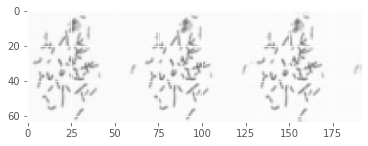

Test Images: Low Res, High Res, Predicted (PSNR: 33.37, SSIM: 0.98)


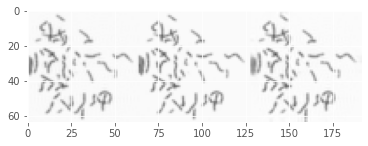

Test Images: Low Res, High Res, Predicted (PSNR: 31.22, SSIM: 0.96)


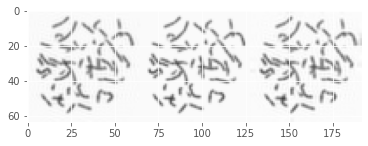

Test Images: Low Res, High Res, Predicted (PSNR: 29.95, SSIM: 0.96)


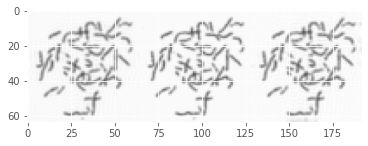

Test Images: Low Res, High Res, Predicted (PSNR: 28.73, SSIM: 0.96)


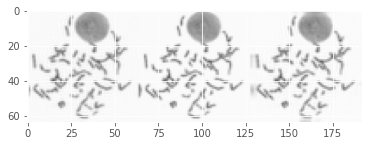

Test Images: Low Res, High Res, Predicted (PSNR: 35.42, SSIM: 0.99)


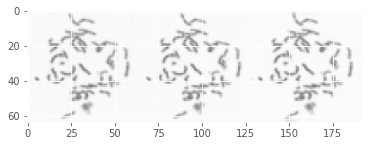

Test Images: Low Res, High Res, Predicted (PSNR: 34.08, SSIM: 0.99)


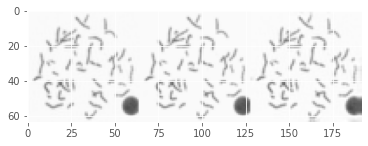

Test Images: Low Res, High Res, Predicted (PSNR: 32.32, SSIM: 0.99)


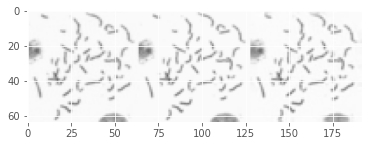

Test Images: Low Res, High Res, Predicted (PSNR: 32.07, SSIM: 0.97)


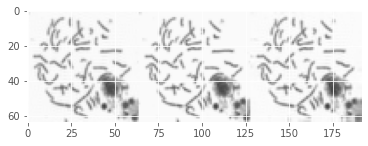

Test Images: Low Res, High Res, Predicted (PSNR: 33.55, SSIM: 0.98)


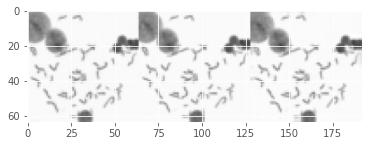

Test Images: Low Res, High Res, Predicted (PSNR: 31.24, SSIM: 0.98)


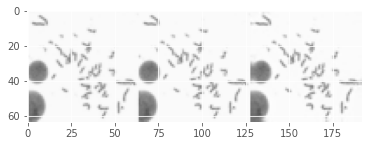

Test Images: Low Res, High Res, Predicted (PSNR: 29.72, SSIM: 0.98)


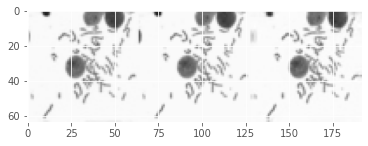

Test Images: Low Res, High Res, Predicted (PSNR: 33.69, SSIM: 0.98)


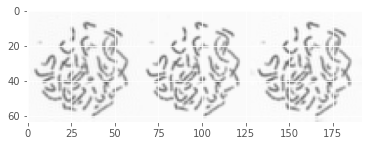

Test Images: Low Res, High Res, Predicted (PSNR: 35.87, SSIM: 0.99)


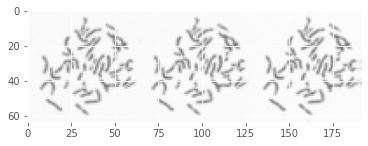

Test Images: Low Res, High Res, Predicted (PSNR: 31.35, SSIM: 0.99)


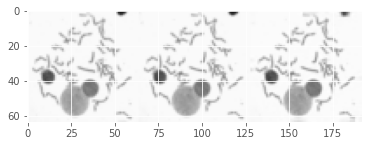

Test Images: Low Res, High Res, Predicted (PSNR: 34.52, SSIM: 0.99)


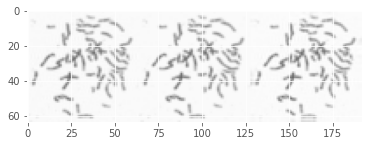

Test Images: Low Res, High Res, Predicted (PSNR: 26.14, SSIM: 0.98)


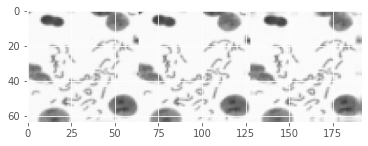

Test Images: Low Res, High Res, Predicted (PSNR: 33.02, SSIM: 0.98)


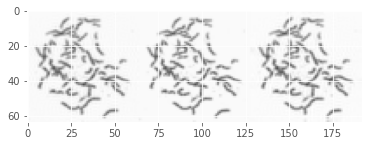

Test Images: Low Res, High Res, Predicted (PSNR: 28.55, SSIM: 0.98)


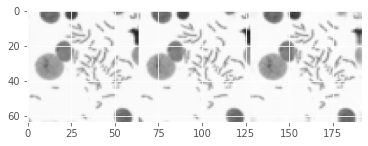

Test Images: Low Res, High Res, Predicted (PSNR: 32.23, SSIM: 0.98)


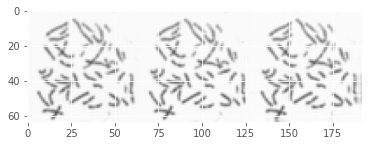

Test Images: Low Res, High Res, Predicted (PSNR: 35.00, SSIM: 0.99)


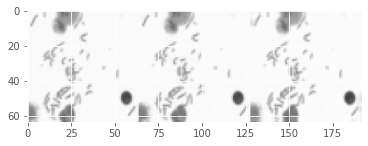

Test Images: Low Res, High Res, Predicted (PSNR: 36.00, SSIM: 0.99)


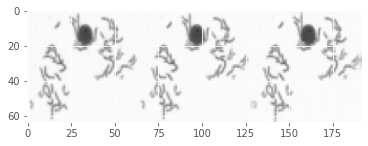

Test Images: Low Res, High Res, Predicted (PSNR: 30.04, SSIM: 0.97)


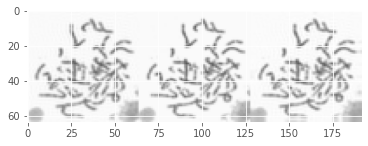

Test Images: Low Res, High Res, Predicted (PSNR: 31.72, SSIM: 0.99)


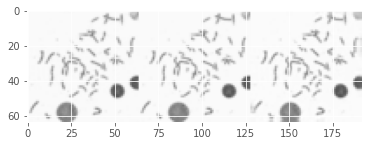

Test Images: Low Res, High Res, Predicted (PSNR: 31.83, SSIM: 0.97)


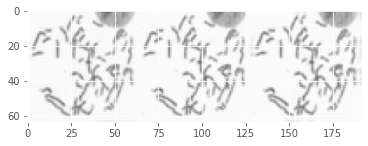

Test Images: Low Res, High Res, Predicted (PSNR: 31.56, SSIM: 0.98)


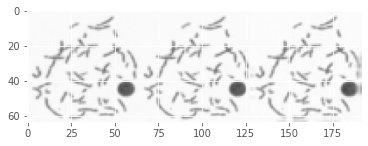

Test Images: Low Res, High Res, Predicted (PSNR: 36.07, SSIM: 0.98)


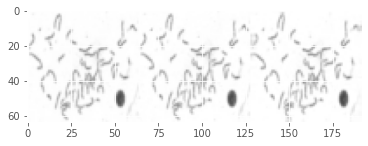

Test Images: Low Res, High Res, Predicted (PSNR: 33.70, SSIM: 0.98)


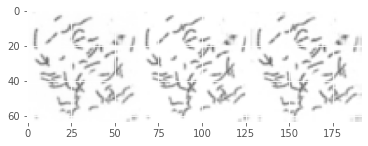

Test Images: Low Res, High Res, Predicted (PSNR: 34.47, SSIM: 0.99)


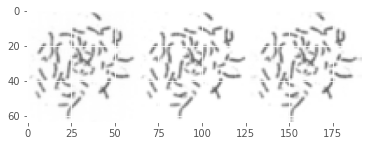

Test Images: Low Res, High Res, Predicted (PSNR: 35.53, SSIM: 0.99)


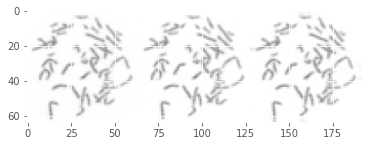

Test Images: Low Res, High Res, Predicted (PSNR: 29.30, SSIM: 0.98)


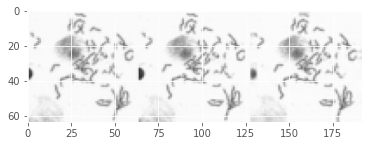

Test Images: Low Res, High Res, Predicted (PSNR: 29.71, SSIM: 0.97)


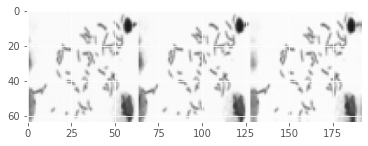

Test Images: Low Res, High Res, Predicted (PSNR: 30.54, SSIM: 0.98)


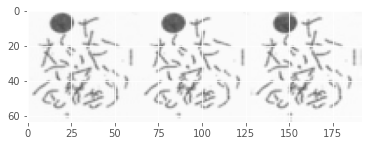

Test Images: Low Res, High Res, Predicted (PSNR: 29.43, SSIM: 0.97)


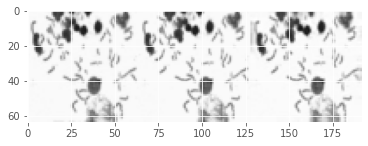

Test Images: Low Res, High Res, Predicted (PSNR: 29.36, SSIM: 0.97)


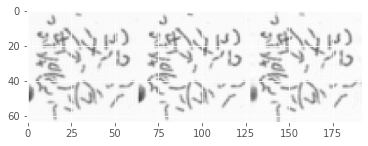

Test Images: Low Res, High Res, Predicted (PSNR: 34.58, SSIM: 0.99)


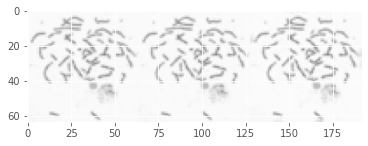

Test Images: Low Res, High Res, Predicted (PSNR: 32.64, SSIM: 0.99)


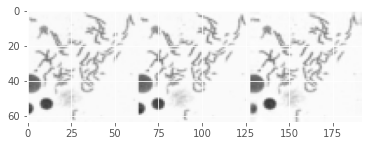

Test Images: Low Res, High Res, Predicted (PSNR: 31.41, SSIM: 0.98)


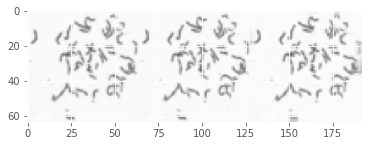

Test Images: Low Res, High Res, Predicted (PSNR: 28.58, SSIM: 0.97)


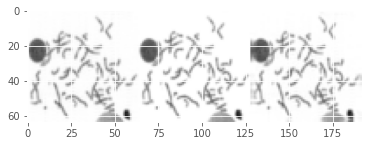

Test Images: Low Res, High Res, Predicted (PSNR: 30.74, SSIM: 0.98)


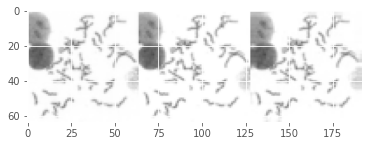

Test Images: Low Res, High Res, Predicted (PSNR: 36.86, SSIM: 0.99)


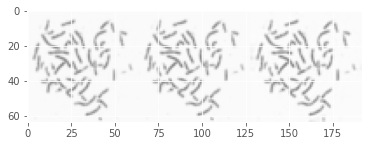

Test Images: Low Res, High Res, Predicted (PSNR: 33.22, SSIM: 0.98)


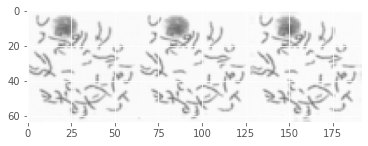

Test Images: Low Res, High Res, Predicted (PSNR: 33.37, SSIM: 0.99)


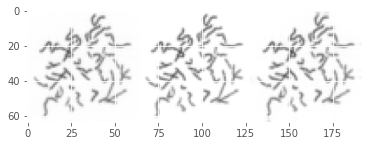

Test Images: Low Res, High Res, Predicted (PSNR: 35.83, SSIM: 0.99)


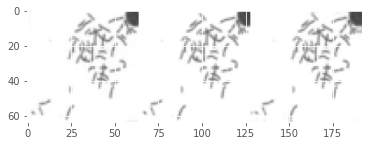

Test Images: Low Res, High Res, Predicted (PSNR: 34.60, SSIM: 0.99)


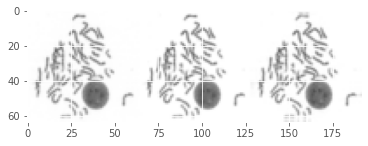

Test Images: Low Res, High Res, Predicted (PSNR: 38.32, SSIM: 0.99)


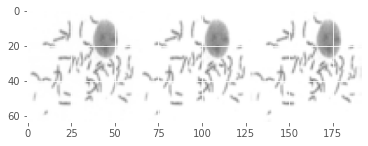

Test Images: Low Res, High Res, Predicted (PSNR: 29.68, SSIM: 0.98)


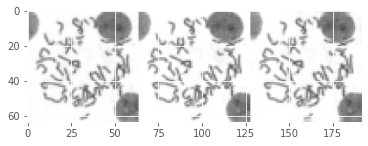

Test Images: Low Res, High Res, Predicted (PSNR: 34.15, SSIM: 0.99)


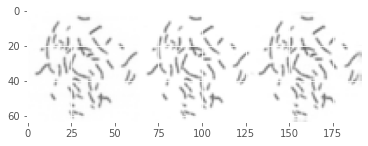

Test Images: Low Res, High Res, Predicted (PSNR: 31.47, SSIM: 0.99)


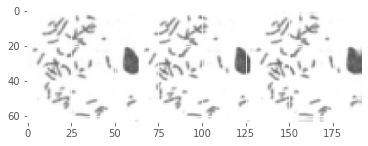

Test Images: Low Res, High Res, Predicted (PSNR: 30.71, SSIM: 0.98)


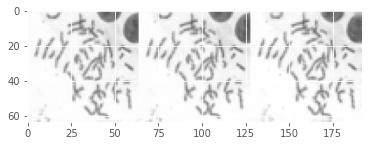

Test Images: Low Res, High Res, Predicted (PSNR: 41.08, SSIM: 0.99)


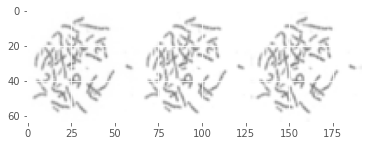

Test Images: Low Res, High Res, Predicted (PSNR: 32.72, SSIM: 0.99)


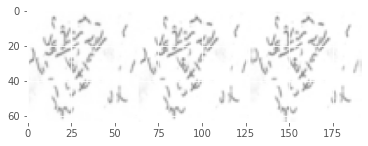

Test Images: Low Res, High Res, Predicted (PSNR: 31.53, SSIM: 0.98)


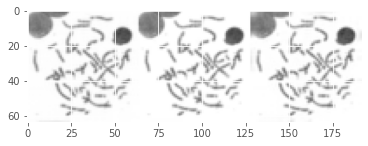

Test Images: Low Res, High Res, Predicted (PSNR: 30.27, SSIM: 0.98)


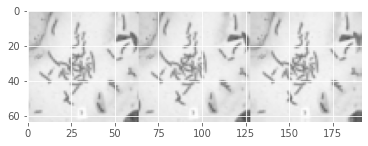

Test Images: Low Res, High Res, Predicted (PSNR: 35.05, SSIM: 0.99)


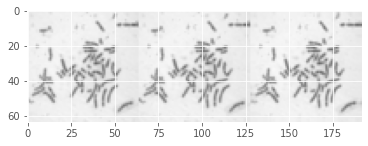

Test Images: Low Res, High Res, Predicted (PSNR: 32.01, SSIM: 0.99)


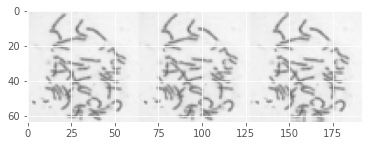

Test Images: Low Res, High Res, Predicted (PSNR: 36.01, SSIM: 0.99)


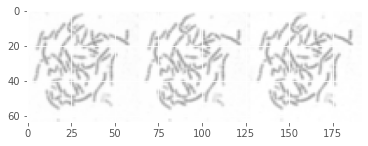

Test Images: Low Res, High Res, Predicted (PSNR: 34.22, SSIM: 0.99)


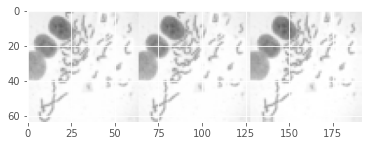

Test Images: Low Res, High Res, Predicted (PSNR: 28.00, SSIM: 0.98)


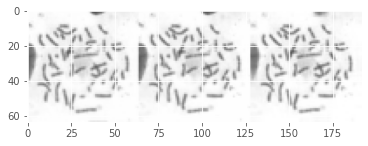

Test Images: Low Res, High Res, Predicted (PSNR: 34.52, SSIM: 0.99)


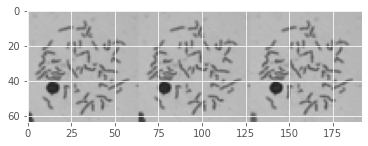

Test Images: Low Res, High Res, Predicted (PSNR: 38.28, SSIM: 0.99)


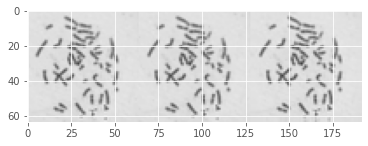

Test Images: Low Res, High Res, Predicted (PSNR: 37.83, SSIM: 0.98)


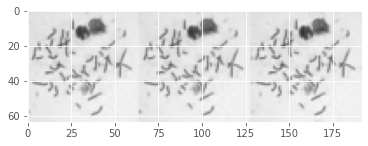

Test Images: Low Res, High Res, Predicted (PSNR: 29.21, SSIM: 0.98)


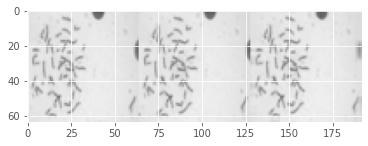

Test Images: Low Res, High Res, Predicted (PSNR: 40.90, SSIM: 0.99)


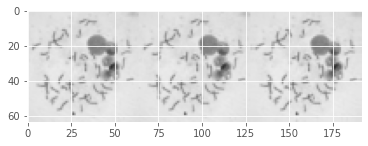

Test Images: Low Res, High Res, Predicted (PSNR: 36.34, SSIM: 0.99)


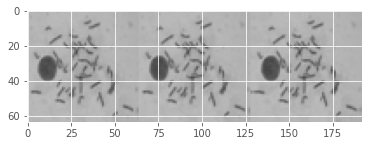

Test Images: Low Res, High Res, Predicted (PSNR: 32.02, SSIM: 0.99)


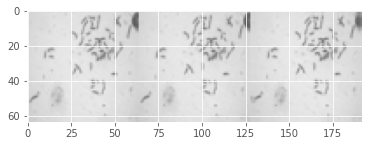

Test Images: Low Res, High Res, Predicted (PSNR: 29.04, SSIM: 0.98)


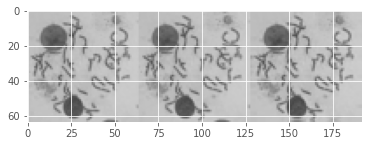

Test Images: Low Res, High Res, Predicted (PSNR: 30.99, SSIM: 0.98)


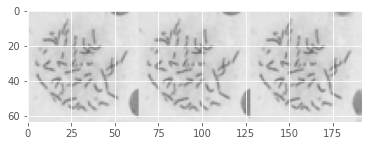

Test Images: Low Res, High Res, Predicted (PSNR: 33.49, SSIM: 0.98)


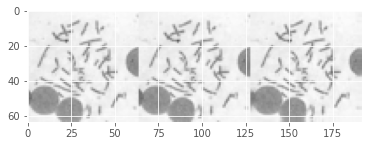

Test Images: Low Res, High Res, Predicted (PSNR: 33.05, SSIM: 0.98)


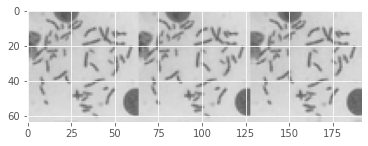

Test Images: Low Res, High Res, Predicted (PSNR: 35.25, SSIM: 0.98)


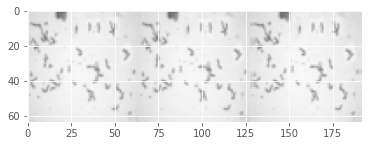

Test Images: Low Res, High Res, Predicted (PSNR: 33.69, SSIM: 0.99)


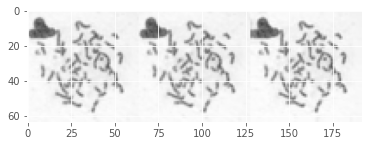

Test Images: Low Res, High Res, Predicted (PSNR: 37.90, SSIM: 0.99)


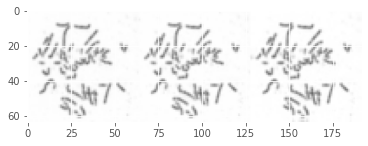

Test Images: Low Res, High Res, Predicted (PSNR: 35.84, SSIM: 0.99)


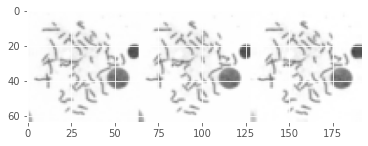

Test Images: Low Res, High Res, Predicted (PSNR: 30.46, SSIM: 0.97)


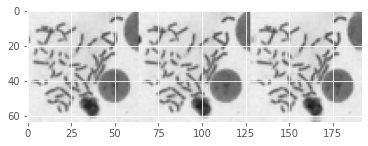

Test Images: Low Res, High Res, Predicted (PSNR: 32.43, SSIM: 0.99)


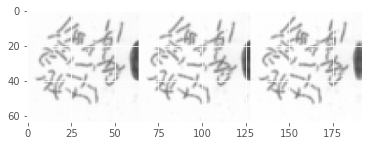

Test Images: Low Res, High Res, Predicted (PSNR: 30.46, SSIM: 0.98)


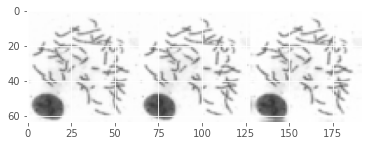

Test Images: Low Res, High Res, Predicted (PSNR: 32.91, SSIM: 0.98)


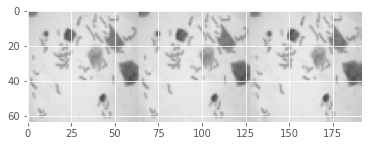

Test Images: Low Res, High Res, Predicted (PSNR: 34.51, SSIM: 0.98)


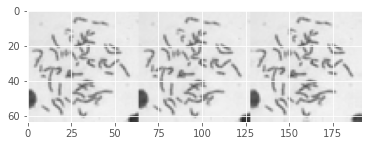

Test Images: Low Res, High Res, Predicted (PSNR: 32.19, SSIM: 0.98)


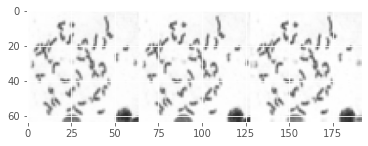

Test Images: Low Res, High Res, Predicted (PSNR: 32.40, SSIM: 0.97)


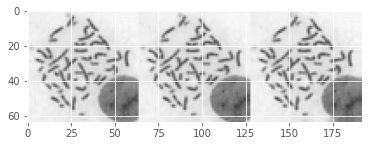

Test Images: Low Res, High Res, Predicted (PSNR: 28.81, SSIM: 0.97)


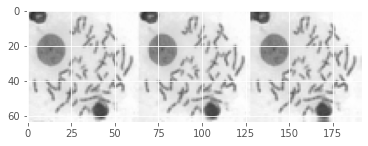

Test Images: Low Res, High Res, Predicted (PSNR: 34.78, SSIM: 0.98)


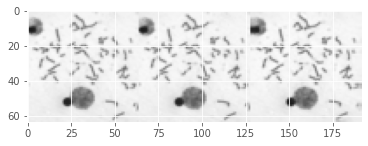

Test Images: Low Res, High Res, Predicted (PSNR: 37.52, SSIM: 0.99)


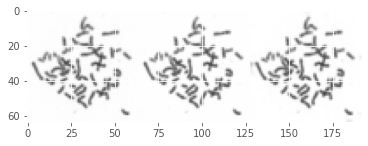

Test Images: Low Res, High Res, Predicted (PSNR: 36.99, SSIM: 0.99)


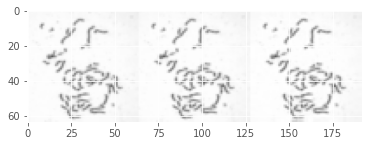

Test Images: Low Res, High Res, Predicted (PSNR: 28.69, SSIM: 0.98)


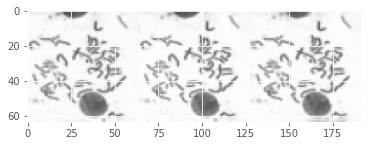

Test Images: Low Res, High Res, Predicted (PSNR: 30.98, SSIM: 0.98)


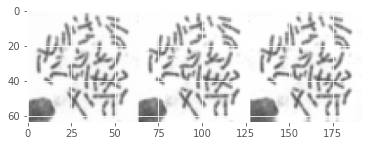

Test Images: Low Res, High Res, Predicted (PSNR: 36.48, SSIM: 0.99)


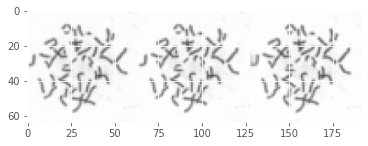

Test Images: Low Res, High Res, Predicted (PSNR: 42.30, SSIM: 0.99)


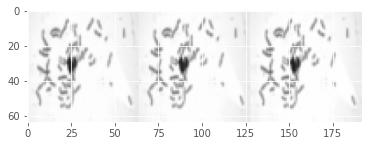

Test Images: Low Res, High Res, Predicted (PSNR: 34.60, SSIM: 0.99)


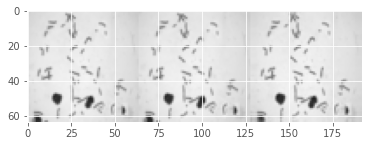

Test Images: Low Res, High Res, Predicted (PSNR: 33.90, SSIM: 0.98)


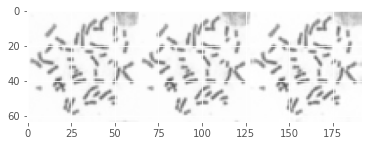

Test Images: Low Res, High Res, Predicted (PSNR: 25.23, SSIM: 0.96)


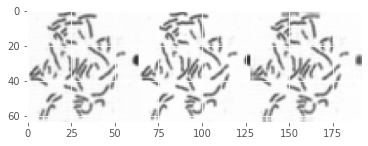

Test Images: Low Res, High Res, Predicted (PSNR: 33.88, SSIM: 0.98)


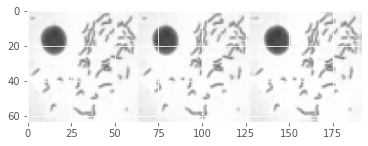

Test Images: Low Res, High Res, Predicted (PSNR: 39.46, SSIM: 0.99)


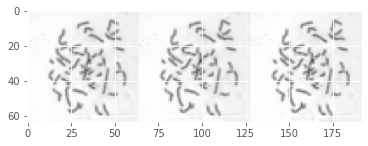

Test Images: Low Res, High Res, Predicted (PSNR: 31.96, SSIM: 0.99)


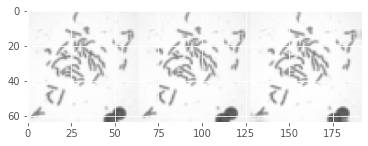

Test Images: Low Res, High Res, Predicted (PSNR: 37.74, SSIM: 0.99)


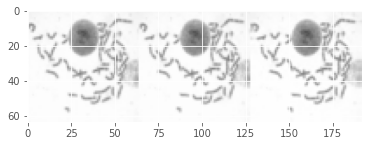

Test Images: Low Res, High Res, Predicted (PSNR: 30.07, SSIM: 0.98)


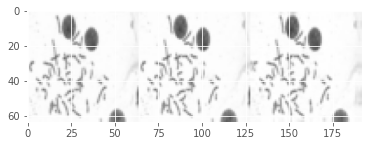

Test Images: Low Res, High Res, Predicted (PSNR: 31.68, SSIM: 0.98)


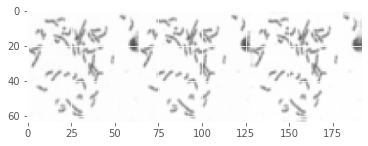

Test Images: Low Res, High Res, Predicted (PSNR: 35.71, SSIM: 0.99)


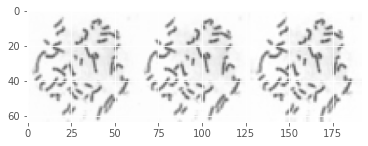

Test Images: Low Res, High Res, Predicted (PSNR: 38.77, SSIM: 1.00)


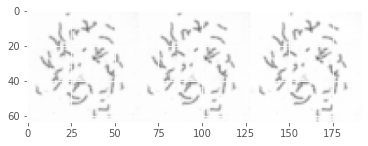

Test Images: Low Res, High Res, Predicted (PSNR: 33.60, SSIM: 0.99)


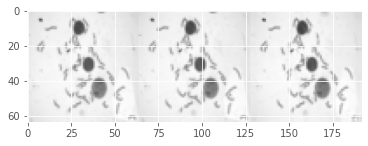

Test Images: Low Res, High Res, Predicted (PSNR: 29.59, SSIM: 0.99)


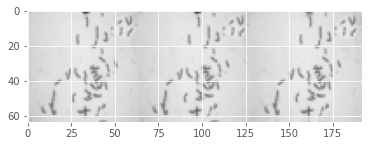

Test Images: Low Res, High Res, Predicted (PSNR: 35.12, SSIM: 0.99)


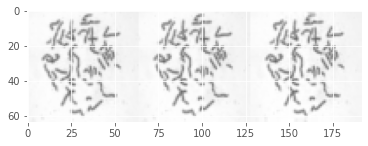

Test Images: Low Res, High Res, Predicted (PSNR: 35.54, SSIM: 0.99)


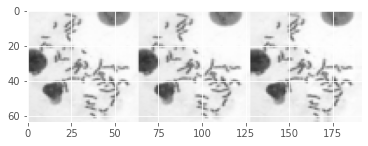

Test Images: Low Res, High Res, Predicted (PSNR: 36.22, SSIM: 0.99)


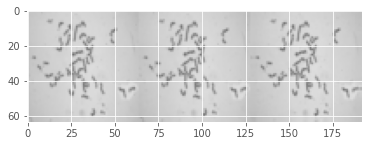

Test Images: Low Res, High Res, Predicted (PSNR: 30.89, SSIM: 0.98)


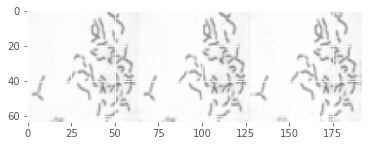

Test Images: Low Res, High Res, Predicted (PSNR: 30.94, SSIM: 0.99)


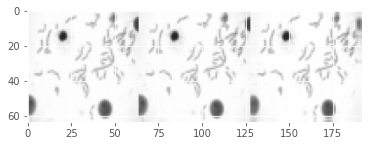

Test Images: Low Res, High Res, Predicted (PSNR: 33.59, SSIM: 1.00)


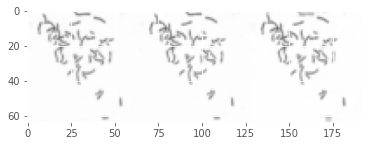

Test Images: Low Res, High Res, Predicted (PSNR: 29.26, SSIM: 0.98)


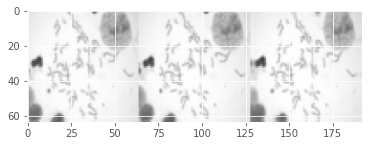

Test Images: Low Res, High Res, Predicted (PSNR: 35.49, SSIM: 0.98)


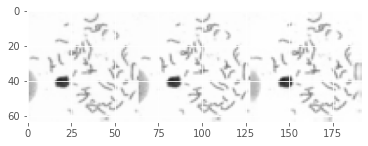

Test Images: Low Res, High Res, Predicted (PSNR: 33.84, SSIM: 0.99)


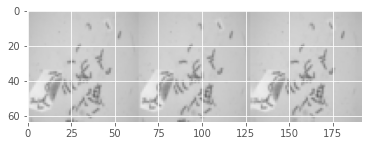

Test Images: Low Res, High Res, Predicted (PSNR: 39.59, SSIM: 0.99)


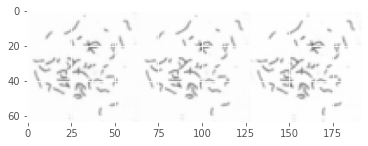

Test Images: Low Res, High Res, Predicted (PSNR: 32.67, SSIM: 0.98)


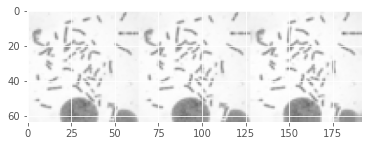

Test Images: Low Res, High Res, Predicted (PSNR: 30.54, SSIM: 0.98)


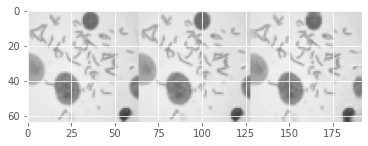

Test Images: Low Res, High Res, Predicted (PSNR: 33.72, SSIM: 0.98)


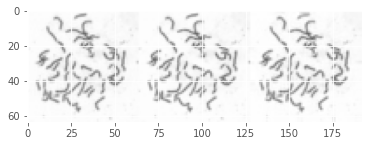

Test Images: Low Res, High Res, Predicted (PSNR: 34.80, SSIM: 0.99)


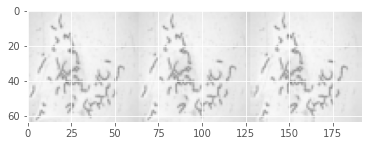

Test Images: Low Res, High Res, Predicted (PSNR: 34.58, SSIM: 0.99)


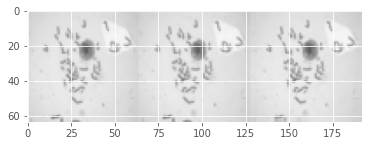

Test Images: Low Res, High Res, Predicted (PSNR: 34.72, SSIM: 0.99)


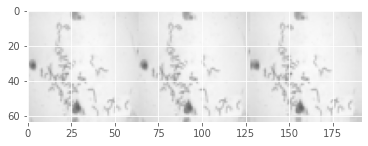

Test Images: Low Res, High Res, Predicted (PSNR: 38.00, SSIM: 0.99)


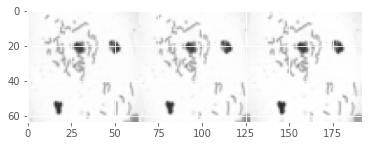

Test Images: Low Res, High Res, Predicted (PSNR: 27.90, SSIM: 0.99)


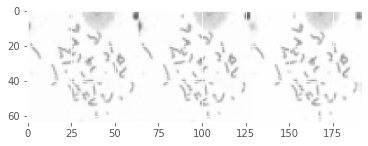

Test Images: Low Res, High Res, Predicted (PSNR: 29.96, SSIM: 0.97)


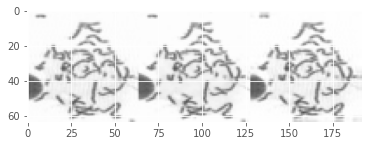

Test Images: Low Res, High Res, Predicted (PSNR: 32.74, SSIM: 0.99)


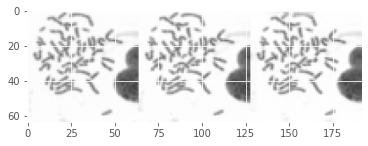

Test Images: Low Res, High Res, Predicted (PSNR: 32.03, SSIM: 0.99)


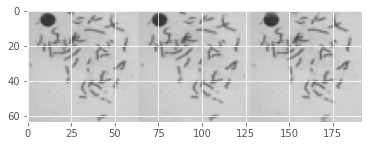

Test Images: Low Res, High Res, Predicted (PSNR: 30.28, SSIM: 0.98)


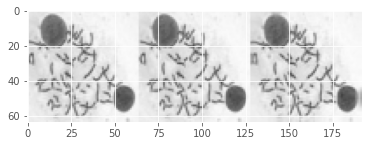

Test Images: Low Res, High Res, Predicted (PSNR: 31.84, SSIM: 0.98)


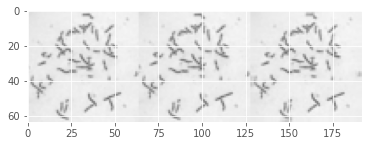

Test Images: Low Res, High Res, Predicted (PSNR: 27.87, SSIM: 0.98)


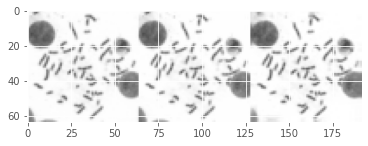

Test Images: Low Res, High Res, Predicted (PSNR: 28.40, SSIM: 0.98)


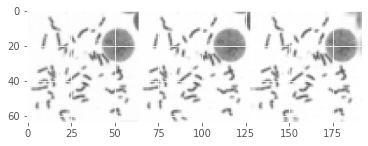

Test Images: Low Res, High Res, Predicted (PSNR: 33.17, SSIM: 0.99)


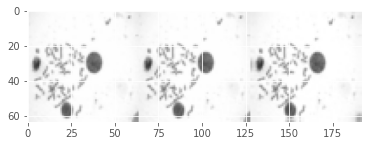

Test Images: Low Res, High Res, Predicted (PSNR: 30.67, SSIM: 0.97)


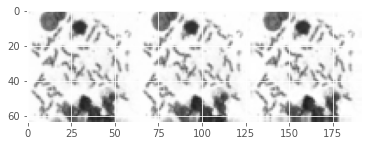

Test Images: Low Res, High Res, Predicted (PSNR: 31.01, SSIM: 0.98)


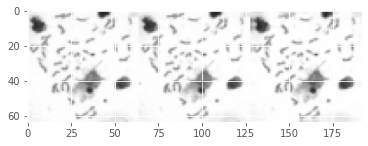

Test Images: Low Res, High Res, Predicted (PSNR: 35.18, SSIM: 0.98)


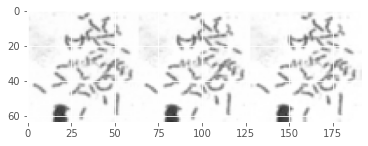

Test Images: Low Res, High Res, Predicted (PSNR: 32.69, SSIM: 0.98)


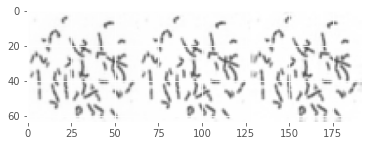

Test Images: Low Res, High Res, Predicted (PSNR: 29.86, SSIM: 0.98)


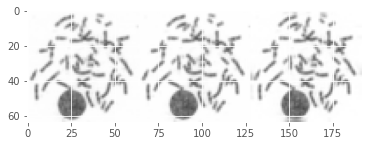

Test Images: Low Res, High Res, Predicted (PSNR: 33.97, SSIM: 0.99)


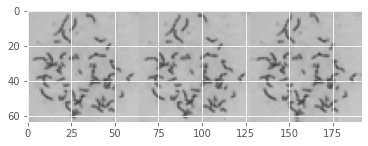

Test Images: Low Res, High Res, Predicted (PSNR: 28.43, SSIM: 0.97)


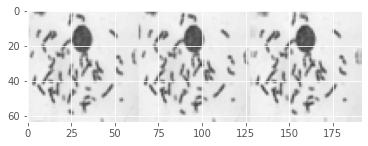

Test Images: Low Res, High Res, Predicted (PSNR: 28.88, SSIM: 0.98)


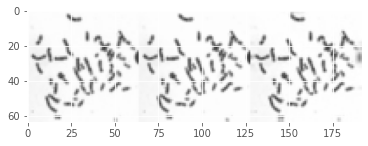

Test Images: Low Res, High Res, Predicted (PSNR: 31.89, SSIM: 0.98)


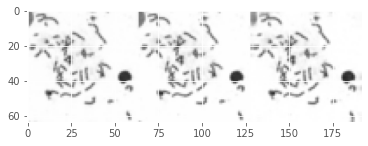

Test Images: Low Res, High Res, Predicted (PSNR: 30.33, SSIM: 0.98)


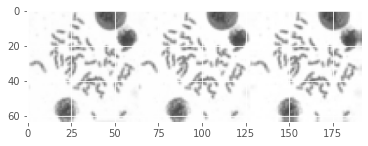

Test Images: Low Res, High Res, Predicted (PSNR: 29.98, SSIM: 0.97)


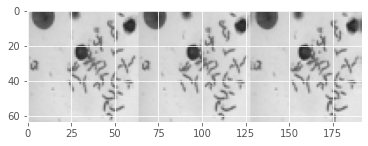

Test Images: Low Res, High Res, Predicted (PSNR: 28.26, SSIM: 0.98)


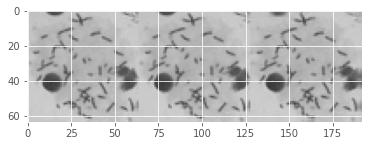

Test Images: Low Res, High Res, Predicted (PSNR: 29.25, SSIM: 0.97)


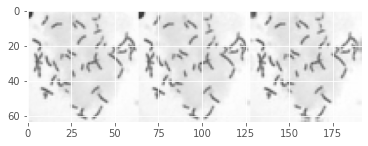

Test Images: Low Res, High Res, Predicted (PSNR: 30.73, SSIM: 0.98)


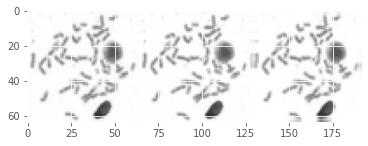

Test Images: Low Res, High Res, Predicted (PSNR: 36.68, SSIM: 0.99)


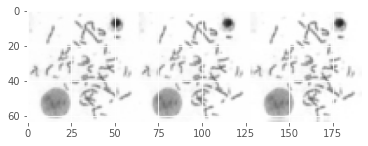

Test Images: Low Res, High Res, Predicted (PSNR: 30.65, SSIM: 0.98)


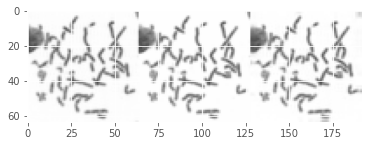

Test Images: Low Res, High Res, Predicted (PSNR: 31.52, SSIM: 0.98)


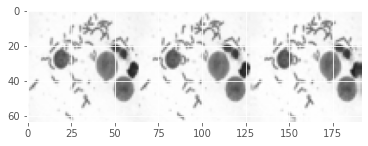

Test Images: Low Res, High Res, Predicted (PSNR: 30.53, SSIM: 0.98)


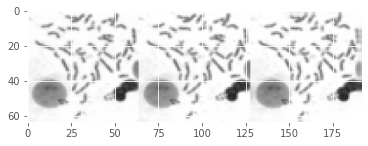

Test Images: Low Res, High Res, Predicted (PSNR: 28.76, SSIM: 0.98)


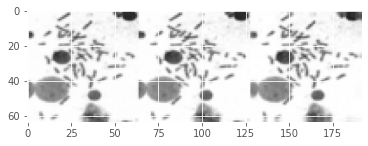

Test Images: Low Res, High Res, Predicted (PSNR: 29.74, SSIM: 0.98)


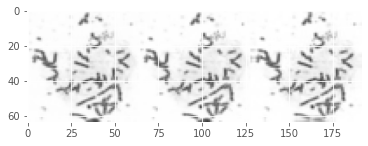

Test Images: Low Res, High Res, Predicted (PSNR: 29.30, SSIM: 0.98)


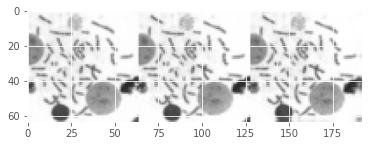

Test Images: Low Res, High Res, Predicted (PSNR: 31.48, SSIM: 0.97)


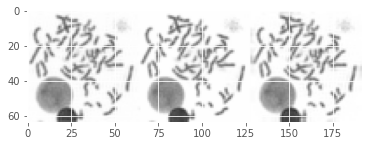

Test Images: Low Res, High Res, Predicted (PSNR: 30.57, SSIM: 0.98)


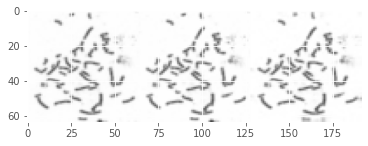

Test Images: Low Res, High Res, Predicted (PSNR: 31.46, SSIM: 0.97)


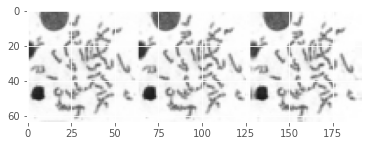

Test Images: Low Res, High Res, Predicted (PSNR: 32.03, SSIM: 0.98)


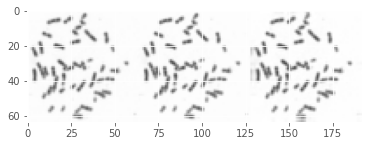

Test Images: Low Res, High Res, Predicted (PSNR: 29.72, SSIM: 0.98)


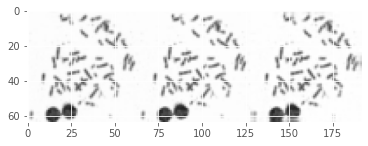

Test Images: Low Res, High Res, Predicted (PSNR: 32.51, SSIM: 0.99)


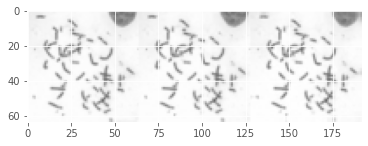

Test Images: Low Res, High Res, Predicted (PSNR: 32.10, SSIM: 0.99)


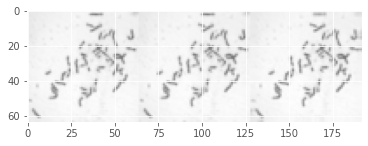

Test Images: Low Res, High Res, Predicted (PSNR: 33.46, SSIM: 0.99)


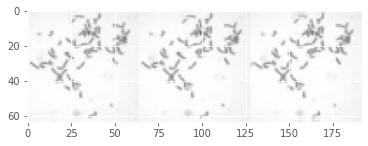

Test Images: Low Res, High Res, Predicted (PSNR: 36.96, SSIM: 0.99)


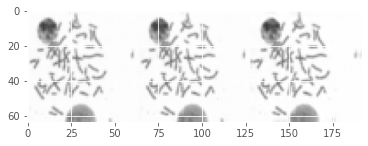

Test Images: Low Res, High Res, Predicted (PSNR: 33.22, SSIM: 0.98)


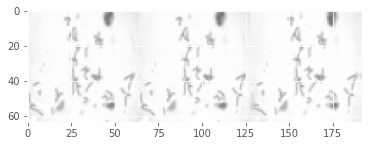

Test Images: Low Res, High Res, Predicted (PSNR: 38.82, SSIM: 0.99)


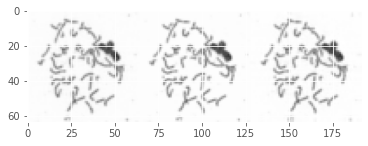

Test Images: Low Res, High Res, Predicted (PSNR: 31.79, SSIM: 0.98)


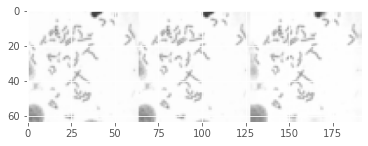

Test Images: Low Res, High Res, Predicted (PSNR: 38.92, SSIM: 0.99)


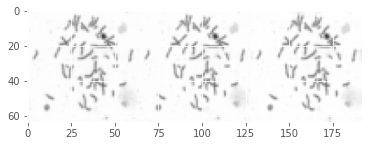

Test Images: Low Res, High Res, Predicted (PSNR: 31.87, SSIM: 0.99)


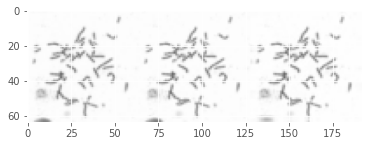

Test Images: Low Res, High Res, Predicted (PSNR: 37.32, SSIM: 0.99)


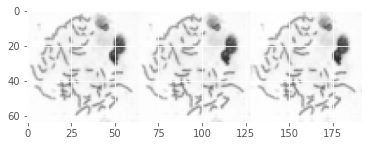

Test Images: Low Res, High Res, Predicted (PSNR: 34.03, SSIM: 0.98)


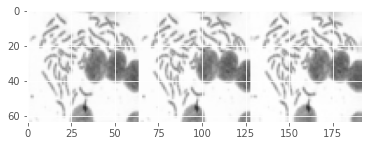

Test Images: Low Res, High Res, Predicted (PSNR: 30.12, SSIM: 0.97)


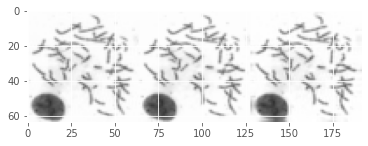

Test Images: Low Res, High Res, Predicted (PSNR: 32.05, SSIM: 0.98)


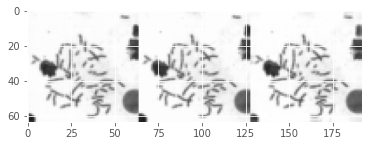

Test Images: Low Res, High Res, Predicted (PSNR: 37.81, SSIM: 0.99)


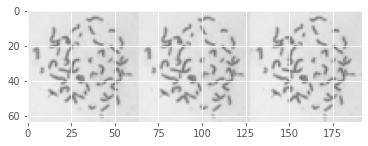

Test Images: Low Res, High Res, Predicted (PSNR: 37.82, SSIM: 0.99)


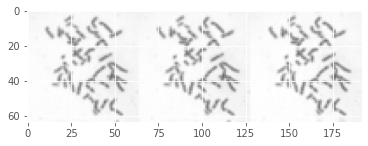

Test Images: Low Res, High Res, Predicted (PSNR: 37.63, SSIM: 0.99)


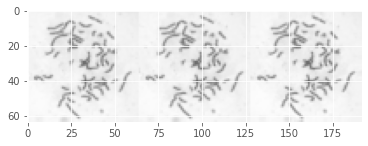

Test Images: Low Res, High Res, Predicted (PSNR: 27.92, SSIM: 0.98)


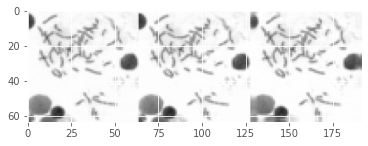

Test Images: Low Res, High Res, Predicted (PSNR: 29.49, SSIM: 0.98)


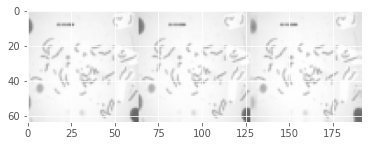

Test Images: Low Res, High Res, Predicted (PSNR: 32.92, SSIM: 0.99)


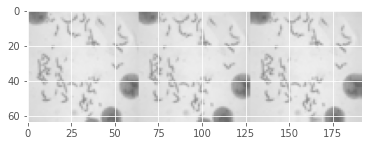

Test Images: Low Res, High Res, Predicted (PSNR: 40.23, SSIM: 0.99)


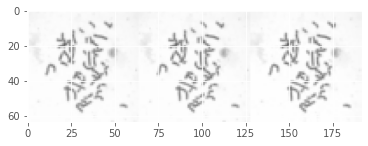

Test Images: Low Res, High Res, Predicted (PSNR: 33.39, SSIM: 0.98)


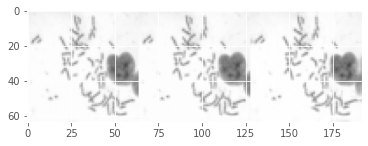

Test Images: Low Res, High Res, Predicted (PSNR: 34.51, SSIM: 0.99)


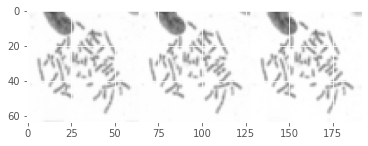

Test Images: Low Res, High Res, Predicted (PSNR: 34.97, SSIM: 0.98)


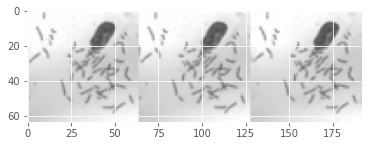

Test Images: Low Res, High Res, Predicted (PSNR: 36.39, SSIM: 0.99)


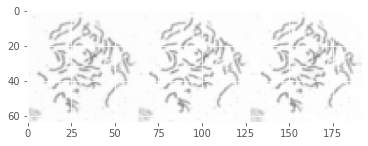

Test Images: Low Res, High Res, Predicted (PSNR: 30.99, SSIM: 0.99)


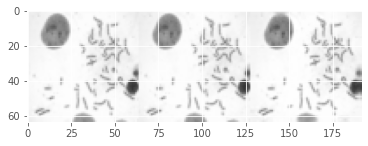

Test Images: Low Res, High Res, Predicted (PSNR: 32.81, SSIM: 0.99)


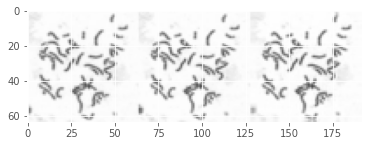

Test Images: Low Res, High Res, Predicted (PSNR: 37.20, SSIM: 0.99)


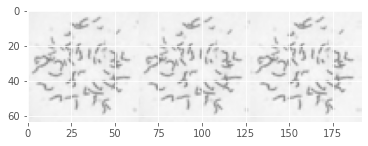

Test Images: Low Res, High Res, Predicted (PSNR: 29.82, SSIM: 0.98)


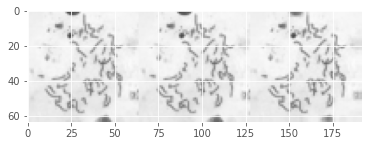

Test Images: Low Res, High Res, Predicted (PSNR: 38.26, SSIM: 0.99)


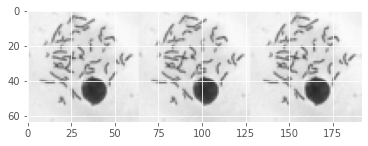

Test Images: Low Res, High Res, Predicted (PSNR: 34.39, SSIM: 0.98)


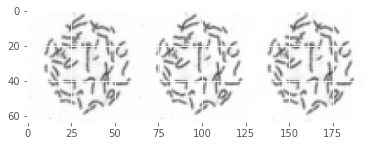

Test Images: Low Res, High Res, Predicted (PSNR: 35.08, SSIM: 0.98)


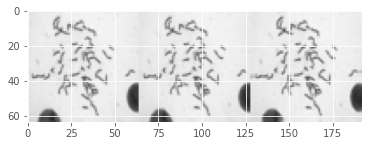

Test Images: Low Res, High Res, Predicted (PSNR: 37.42, SSIM: 0.99)


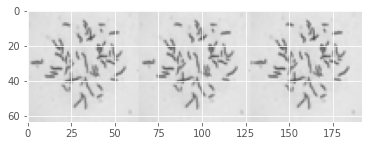

Test Images: Low Res, High Res, Predicted (PSNR: 36.96, SSIM: 0.99)


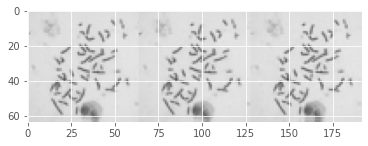

Test Images: Low Res, High Res, Predicted (PSNR: 39.25, SSIM: 0.99)


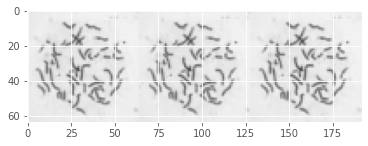

Test Images: Low Res, High Res, Predicted (PSNR: 37.31, SSIM: 0.99)


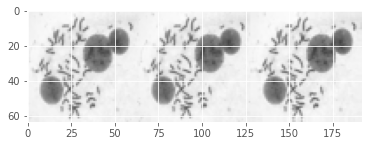

Test Images: Low Res, High Res, Predicted (PSNR: 33.73, SSIM: 0.98)


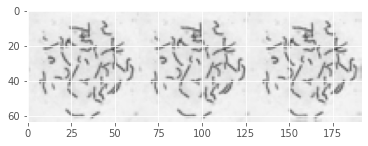

Test Images: Low Res, High Res, Predicted (PSNR: 35.19, SSIM: 0.99)


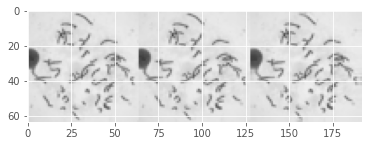

Test Images: Low Res, High Res, Predicted (PSNR: 38.27, SSIM: 0.98)


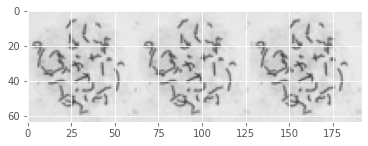

Test Images: Low Res, High Res, Predicted (PSNR: 30.27, SSIM: 0.97)


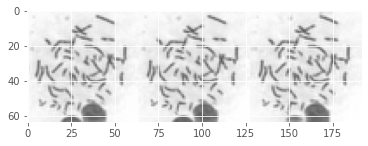

Test Images: Low Res, High Res, Predicted (PSNR: 35.19, SSIM: 0.99)


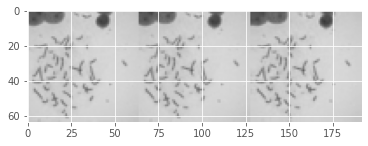

Test Images: Low Res, High Res, Predicted (PSNR: 38.36, SSIM: 0.99)


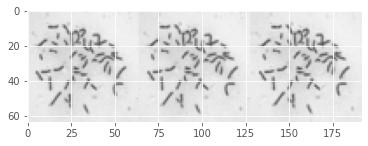

Test Images: Low Res, High Res, Predicted (PSNR: 34.16, SSIM: 0.99)


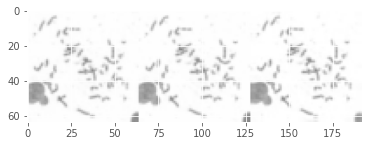

Test Images: Low Res, High Res, Predicted (PSNR: 30.91, SSIM: 0.98)


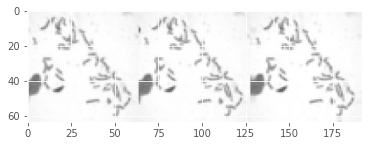

Test Images: Low Res, High Res, Predicted (PSNR: 29.58, SSIM: 0.98)


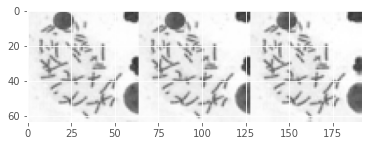

Test Images: Low Res, High Res, Predicted (PSNR: 32.86, SSIM: 0.98)


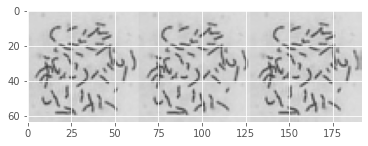

Test Images: Low Res, High Res, Predicted (PSNR: 37.76, SSIM: 0.99)


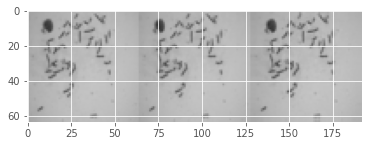

Test Images: Low Res, High Res, Predicted (PSNR: 28.50, SSIM: 0.98)


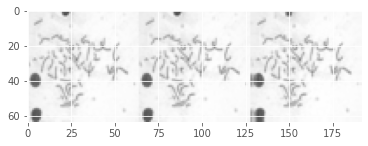

Test Images: Low Res, High Res, Predicted (PSNR: 40.22, SSIM: 0.99)


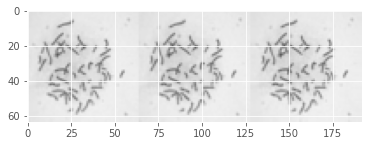

Test Images: Low Res, High Res, Predicted (PSNR: 37.57, SSIM: 0.99)


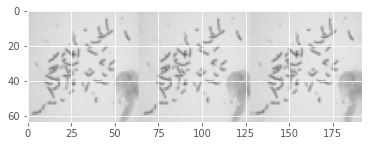

Test Images: Low Res, High Res, Predicted (PSNR: 35.47, SSIM: 0.99)


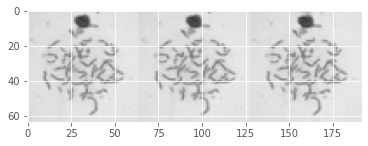

Test Images: Low Res, High Res, Predicted (PSNR: 34.39, SSIM: 0.99)


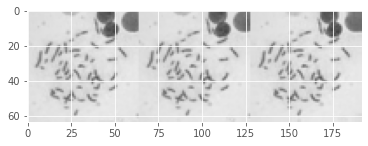

Test Images: Low Res, High Res, Predicted (PSNR: 31.91, SSIM: 0.98)


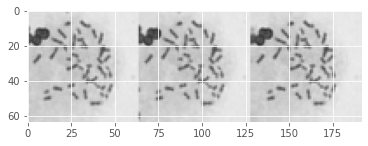

Test Images: Low Res, High Res, Predicted (PSNR: 43.33, SSIM: 1.00)


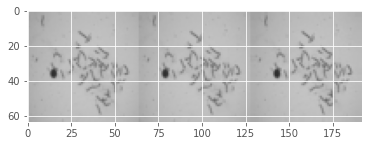

Test Images: Low Res, High Res, Predicted (PSNR: 33.85, SSIM: 0.98)


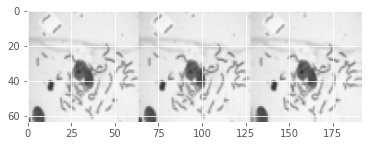

Test Images: Low Res, High Res, Predicted (PSNR: 39.12, SSIM: 0.99)


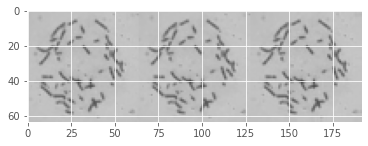

Test Images: Low Res, High Res, Predicted (PSNR: 31.74, SSIM: 0.99)


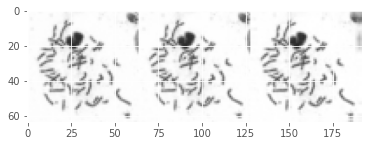

Test Images: Low Res, High Res, Predicted (PSNR: 32.15, SSIM: 0.99)


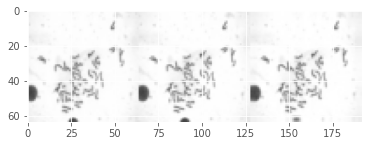

Test Images: Low Res, High Res, Predicted (PSNR: 27.55, SSIM: 0.98)


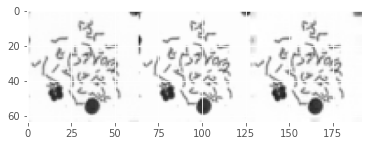

Test Images: Low Res, High Res, Predicted (PSNR: 40.68, SSIM: 0.99)


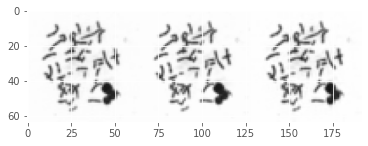

Test Images: Low Res, High Res, Predicted (PSNR: 31.92, SSIM: 0.99)


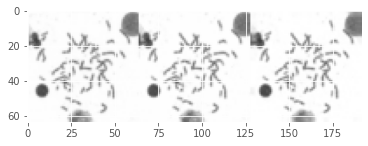

Test Images: Low Res, High Res, Predicted (PSNR: 34.35, SSIM: 0.98)


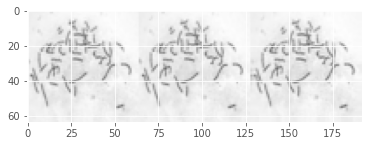

Test Images: Low Res, High Res, Predicted (PSNR: 39.94, SSIM: 0.99)


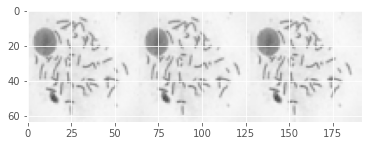

Test Images: Low Res, High Res, Predicted (PSNR: 32.95, SSIM: 0.98)


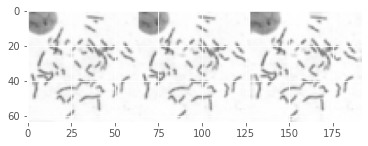

Test Images: Low Res, High Res, Predicted (PSNR: 28.50, SSIM: 0.98)


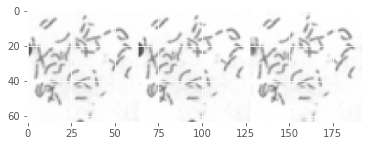

Test Images: Low Res, High Res, Predicted (PSNR: 28.14, SSIM: 0.97)


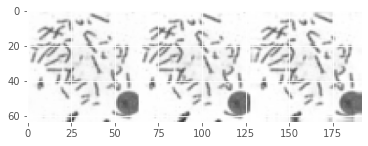

Test Images: Low Res, High Res, Predicted (PSNR: 34.88, SSIM: 0.99)


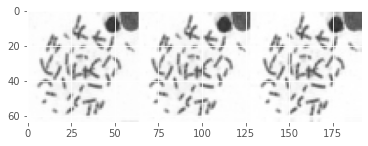

Test Images: Low Res, High Res, Predicted (PSNR: 32.68, SSIM: 0.97)


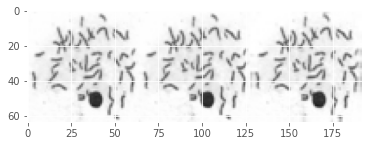

Test Images: Low Res, High Res, Predicted (PSNR: 33.11, SSIM: 0.98)


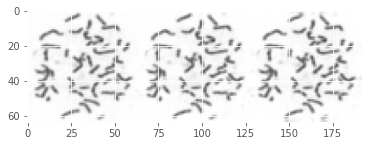

Test Images: Low Res, High Res, Predicted (PSNR: 31.99, SSIM: 0.98)


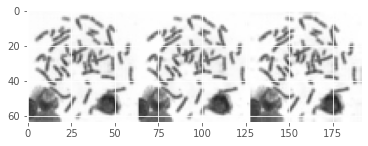

Test Images: Low Res, High Res, Predicted (PSNR: 29.91, SSIM: 0.98)


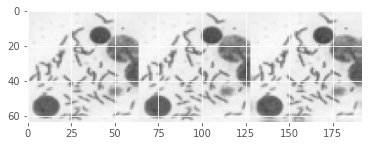

Test Images: Low Res, High Res, Predicted (PSNR: 28.92, SSIM: 0.97)


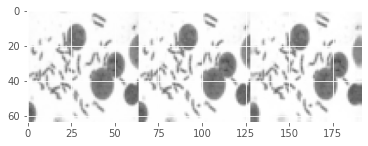

Test Images: Low Res, High Res, Predicted (PSNR: 28.50, SSIM: 0.98)


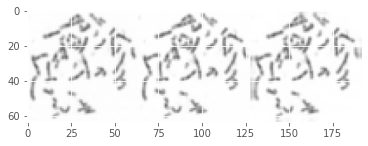

Test Images: Low Res, High Res, Predicted (PSNR: 34.15, SSIM: 0.98)


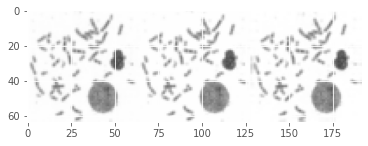

Test Images: Low Res, High Res, Predicted (PSNR: 34.36, SSIM: 0.98)


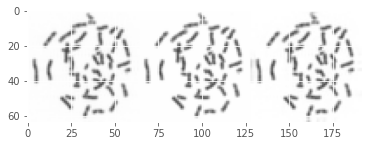

Test Images: Low Res, High Res, Predicted (PSNR: 34.35, SSIM: 0.98)


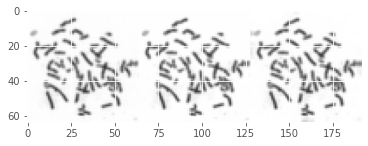

Test Images: Low Res, High Res, Predicted (PSNR: 28.59, SSIM: 0.97)


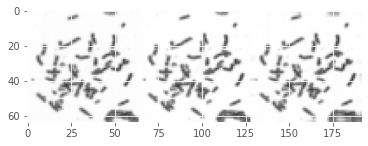

Test Images: Low Res, High Res, Predicted (PSNR: 29.36, SSIM: 0.97)


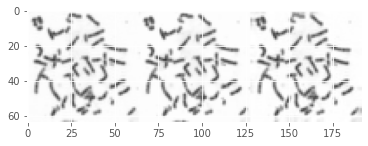

Test Images: Low Res, High Res, Predicted (PSNR: 34.59, SSIM: 0.98)


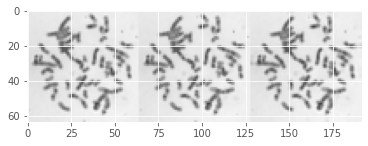

Test Images: Low Res, High Res, Predicted (PSNR: 35.17, SSIM: 0.98)


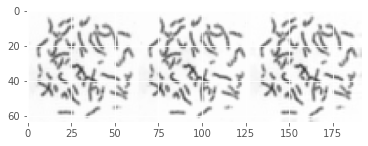

Test Images: Low Res, High Res, Predicted (PSNR: 30.96, SSIM: 0.98)


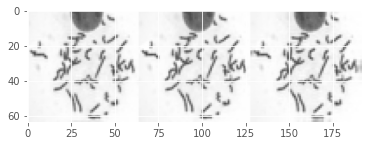

Test Images: Low Res, High Res, Predicted (PSNR: 29.69, SSIM: 0.96)


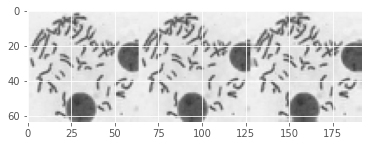

Test Images: Low Res, High Res, Predicted (PSNR: 32.92, SSIM: 0.99)


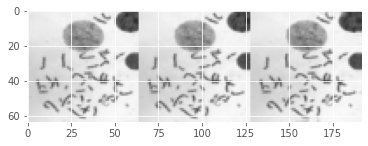

Test Images: Low Res, High Res, Predicted (PSNR: 33.32, SSIM: 0.98)


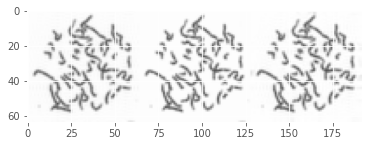

Test Images: Low Res, High Res, Predicted (PSNR: 28.56, SSIM: 0.97)


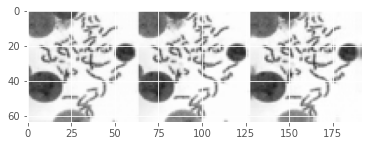

Test Images: Low Res, High Res, Predicted (PSNR: 30.27, SSIM: 0.98)


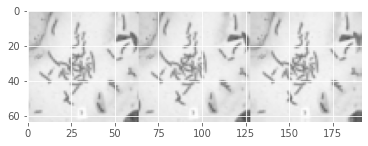

Test Images: Low Res, High Res, Predicted (PSNR: 35.05, SSIM: 0.99)


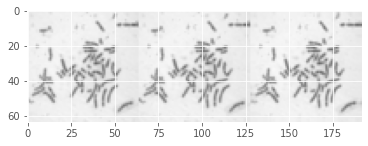

Test Images: Low Res, High Res, Predicted (PSNR: 30.42, SSIM: 0.98)


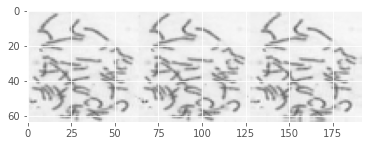

Test Images: Low Res, High Res, Predicted (PSNR: 36.01, SSIM: 0.99)


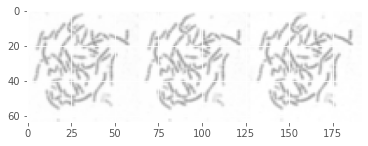

Test Images: Low Res, High Res, Predicted (PSNR: 34.22, SSIM: 0.99)


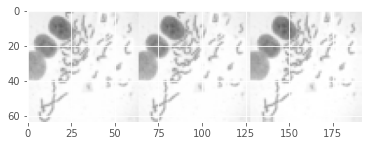

Test Images: Low Res, High Res, Predicted (PSNR: 28.00, SSIM: 0.98)


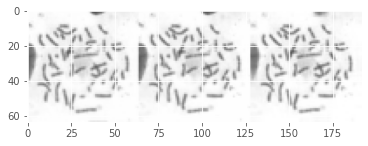

Test Images: Low Res, High Res, Predicted (PSNR: 29.04, SSIM: 0.98)


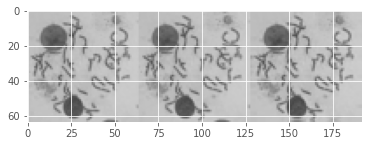

Test Images: Low Res, High Res, Predicted (PSNR: 30.99, SSIM: 0.98)


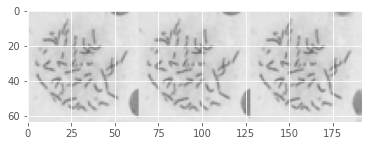

Test Images: Low Res, High Res, Predicted (PSNR: 33.49, SSIM: 0.98)


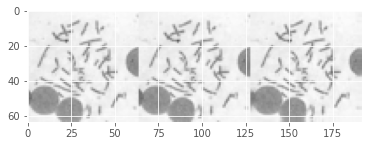

Test Images: Low Res, High Res, Predicted (PSNR: 33.05, SSIM: 0.98)


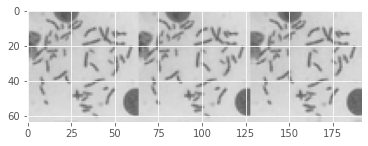

Test Images: Low Res, High Res, Predicted (PSNR: 37.90, SSIM: 0.99)


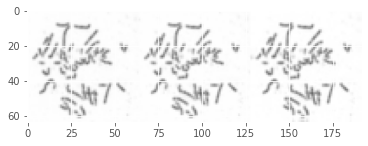

Test Images: Low Res, High Res, Predicted (PSNR: 35.84, SSIM: 0.99)


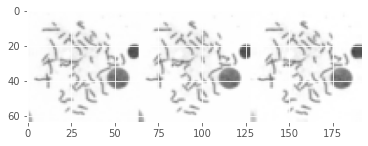

Test Images: Low Res, High Res, Predicted (PSNR: 35.25, SSIM: 0.98)


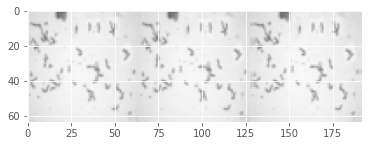

Test Images: Low Res, High Res, Predicted (PSNR: 33.69, SSIM: 0.99)


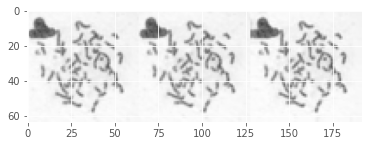

Test Images: Low Res, High Res, Predicted (PSNR: 30.46, SSIM: 0.97)


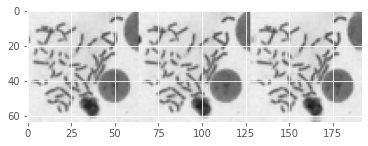

Test Images: Low Res, High Res, Predicted (PSNR: 32.43, SSIM: 0.99)


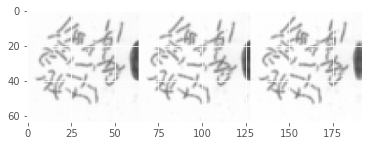

Test Images: Low Res, High Res, Predicted (PSNR: 30.46, SSIM: 0.98)


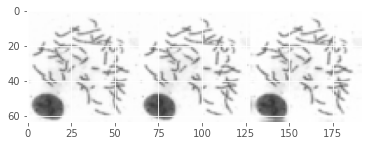

In [61]:
import cv2
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt

# predict test images
with torch.no_grad():
    saved_model.eval()
    for i, (test_low_image, test_high_image) in enumerate(test_loader):
        output = saved_model(test_low_image.to(device))
        output = output.cpu()
        output = output.numpy().transpose(0, 2, 3, 1)
        output = output.squeeze()
        output = (output + 1) / 2 * 255
        output = np.clip(output, 0, 255)
        output = output.astype('uint8')
        
        test_low_image = test_low_image.numpy().transpose(0, 2, 3, 1)
        test_low_image = test_low_image.squeeze()
        test_low_image = (test_low_image + 1) / 2 * 255
        test_low_image = np.clip(test_low_image, 0, 255)
        test_low_image = test_low_image.astype('uint8')
        
        test_high_image = test_high_image.numpy().transpose(0, 2, 3, 1)
        test_high_image = test_high_image.squeeze()
        test_high_image = (test_high_image + 1) / 2 * 255
        test_high_image = np.clip(test_high_image, 0, 255)
        test_high_image = test_high_image.astype('uint8')
        
        # calculate PSNR and SSIM
        psnr_val = psnr(test_high_image, output, data_range=output.max()-output.min())
        ssim_val = ssim(test_high_image, output, multichannel=True)
        
        # plot images
        output = cv2.cvtColor(output, cv2.COLOR_RGB2BGR)
        test_low_image = cv2.cvtColor(test_low_image, cv2.COLOR_RGB2BGR)
        test_high_image = cv2.cvtColor(test_high_image, cv2.COLOR_RGB2BGR)
        images = np.hstack((test_low_image, test_high_image, output))
        print('Test Images: Low Res, High Res, Predicted (PSNR: {:.2f}, SSIM: {:.2f})'.format(psnr_val, ssim_val))
        plt.imshow(images)
        plt.show()


In [62]:
import cv2
import numpy as np
import torch

# # load the trained model
# model = torch.load('/content/drive/MyDrive/Bioimaging_data/model.pth')

# define a function to preprocess the input image
def preprocess_image(img_path):
    img = cv2.imread(img_path,0)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)[:, :, 0]
    img = cv2.resize(img, (64, 64), cv2.INTER_CUBIC)
    img = img.astype('float32') / 255
    # img = img.transpose(2, 0, 1)
    img = np.expand_dims(img, axis=0)
    img = torch.from_numpy(img)
    return img

# upload a low resolution image and a high resolution image
low_res_image_path = "Bioimaging_data3\A0.3\\103064_0.3.jpg"
high_res_image_path = "Bioimaging_data3\A0.7\\103064_0.7.jpg"

# preprocess the low resolution image (/content/drive/MyDrive/Bioimaging_data/Test images/1050073_0.3.jpg)
low_res_image = preprocess_image(low_res_image_path)

In [63]:
low_res_image.shape

torch.Size([1, 64, 64])

In [64]:
output = saved_model(low_res_image.to(device))
output = output.cpu()
output = output.detach().numpy()
output = output.squeeze()
output = (output + 1) / 2 * 255
output = np.clip(output, 0, 255)
output = output.astype('uint8')

In [65]:
output.shape

(64, 64)

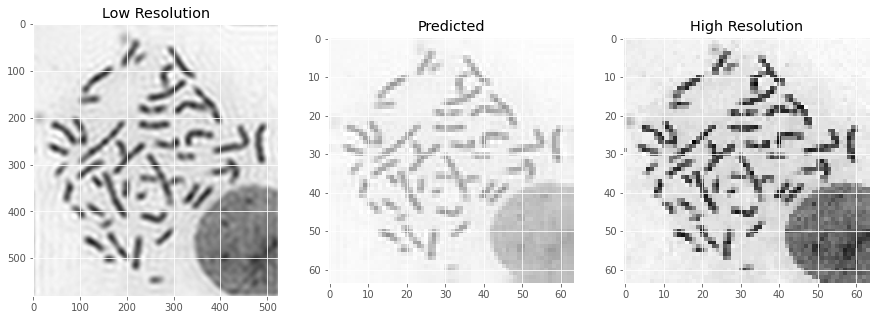

In [67]:
# predict the high resolution image
with torch.no_grad():
    saved_model.eval()
    output = saved_model(low_res_image.to(device))
    output = output.cpu()
    output = output.numpy()
    output = output.squeeze()
    output = (output + 1) / 2 * 255
    output = np.clip(output, 0, 255)
    output = output.astype('uint8')

# preprocess the high resolution image
high_res_image = preprocess_image(high_res_image_path)
high_res_image = high_res_image.numpy()
high_res_image = high_res_image.squeeze()
high_res_image = (high_res_image + 1) / 2 * 255
high_res_image = np.clip(high_res_image, 0, 255)
high_res_image = high_res_image.astype('uint8')

# preprocess the low resolution image for display
low_res_image_display = cv2.imread(low_res_image_path)
low_res_image_display = cv2.cvtColor(low_res_image_display, cv2.COLOR_BGR2RGB)
# low_res_image_display = cv2.resize(low_res_image_display, (256, 256), cv2.INTER_CUBIC)

# preprocess the predicted image for display
output_display = cv2.cvtColor(output, cv2.COLOR_RGB2BGR)
# output_display = cv2.resize(output_display, (256, 256), cv2.INTER_CUBIC)


# plot the images
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(low_res_image_display)
axs[0].set_title('Low Resolution')
axs[2].imshow(high_res_image,cmap="gray")
axs[2].set_title('High Resolution')
axs[1].imshow(output_display)
axs[1].set_title('Predicted')
plt.show()
